In [9]:
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch
from data.utils import set_up_dir
import uuid
import os
import glob
from PIL import Image
import cv2
#from skimage.filters import gaussian
import copy
import torch.nn as nn
import numpy as np
from utils import summary_2inputs,set_up_dir, summary, get_gaussian_kernel
from data_utils import ParallelDataLoader, DataSaver
import torch, torch.nn as nn, torch.nn.functional as F
import matplotlib.image as mpimg
import scipy
import PIL
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Create Data

In [11]:
class CanvasModelBig(nn.Module):
    def __init__(self ):
        super(CanvasModelBig, self).__init__()
        self.conv_bias = False
        
        self.encoder = self.conv_block()
        
    def conv_block(self):
        layers = [ 
        nn.Conv2d(1, 64, kernel_size=5, stride=1, padding=2, bias= self.conv_bias),
        nn.ReLU(True),
        nn.Conv2d(64, 128, kernel_size=5, stride=1, padding=2, bias= self.conv_bias),
        nn.ReLU(True),
        nn.Conv2d(128, 256, kernel_size=5, stride=1, padding=2, bias= self.conv_bias),
        nn.ReLU(True),
        nn.Conv2d(256, 512, kernel_size=5, stride=1, padding=2, bias= self.conv_bias),
        nn.ReLU(True),
        nn.Conv2d(512, 512, kernel_size=1, stride=1, padding=0, bias= self.conv_bias),
        nn.ReLU(True),
        nn.Conv2d(512, 10, kernel_size=1, stride=1, padding=0, bias= self.conv_bias),
       # nn.AvgPool2d(13, stride=13),
        #nn.ReLU(True)
        ]
      #  nn.AdaptiveAvgPool2d(output_size=(3, 3)),

        return nn.Sequential(*layers)
    
    def forward(self, x):
        #print(x.shape)
       # x = F.avg_pool2d(x, kernel_size= 2, stride=2)
        h = self.encoder(x)
        return h
     

In [46]:
from historic_numbers.dataset import HistoricNumbersDataset
data = HistoricNumbersDataset('/home/oeberle/explainable_embeds/historic_numbers/data', csv_file="historic_numbers/numbers.csv", train=True, page_transform=None, return_patches=True,)


0it [00:00, ?it/s]
0it [00:00, ?it/s]
188416it [00:00, 1462227.44it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
204800it [00:00, 1700179.24it/s]
0it [00:00, ?it/s]
155648it [00:00, 1853902.35it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]


212992it [00:00, 1761034.04it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
196608it [00:00, 1490090.06it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
991232it [00:00, 1952887.86it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
991232it [00:00, 2393071.36it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1007616it [00:00, 2690208.63it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
983040it [00:00, 2382665.10it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
983040it [00:00, 2071557.82it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
450560it [00:00, 1580496.64it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
434176it [00:00, 1489243.35it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
385024it [00:00, 1418727.49it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
409600it [00:00, 1565603.59it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
417792it [00:00, 1828423.71it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1818624it [00:00, 3518896.15it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1466368it [00:00, 3216968.38it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1638400it [00:00, 3362170.83it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1843200it [00:00, 3776972.33it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1761280it [00:00, 4081188.93it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1212416it [00:00, 3004089.31it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1089536it [00:00, 3088156.82it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1048576it [00:00, 2588112.29it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
983040it [00:00, 2617454.40it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
1196032it [00:00, 3021824.51it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
229376it [00:00, 1323626.57it/s]
0it [00:00, ?it/s]


0it [00:00, ?it/s]
311296it [00:00, 1578829.70it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]


286720it [00:00, 1396880.10it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

253952it [00:00, 1289572.29it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1638400it [00:00, 3521632.26it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1630208it [00:00, 3544845.12it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1548288it [00:00, 3574852.11it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1155072it [00:00, 2527533.49it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1212416it [00:00, 2900490.40it/s]

0it [00:00, ?it/s]



0it [00:01, ?it/s]

2203648it [00:01, 2042996.08it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

327680it [00:00, 911632.85it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

606208it [00:00, 1601537.81it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

622592it [00:00, 1711654.92it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

614400it [00:00, 1601850.61it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

598016it [00:00, 1806189.59it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

581632it [00:00, 1789231.08it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

598016it [00:00, 2060503.24it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

614400it [00:00, 2203728.30it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

614400it [00:00, 2475549.68it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

352256it [00:00, 1523047.47it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]



466944it [00:00, 2092373.02it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

483328it [00:00, 1704162.98it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]



475136it [00:00, 2211007.22it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

458752it [00:00, 1710581.02it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]



540672it [00:00, 2524982.94it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

966656it [00:00, 3121979.43it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1515520it [00:00, 3536972.57it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

1433600it [00:00, 3453081.39it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

983040it [00:00, 2735070.89it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]

622592it [00:00, 1887420.13it/s]

0it [00:00, ?it/s]



0it [00:00, ?it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


778240it [00:00, 2465409.57it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


884736it [00:00, 3193058.92it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


868352it [00:00, 3025873.74it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


999424it [00:00, 1515153.78it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


1179648it [00:00, 1764681.75it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


1507328it [00:00, 2188460.03it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


1409024it [00:00, 2235437.39it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


1581056it [00:00, 2383317.04it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


1687552it [00:00, 4627277.72it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


2351104it [00:00, 5503875.90it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


2408448it [00:00, 6780648.77it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


3678208it [00:00, 4819787.40it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


3981312it [00:00, 5569346.33it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


3588096it [00:00, 4523636.88it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


3121152it [00:00, 4319608.05it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


3325952it [00:00, 4445853.94it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]


3735552it [00:00, 6600554.86it/s]


0it [00:00, ?it/s]




0it [00:00, ?it/s]



0it [00:00, ?it/s]





0it [00:00, ?it/s]



3457024it [00:01, 34496908.54it/s]



6963200it [00:01, 6025712.24it/s] 



0it [00:00, ?it/s]





0it [00:00, ?it/s]



4947968it [00:00, 49462863.37it/s]



5652480it [00:01, 5501700.52it/s] 



0it [00:00, ?it/s]





0it [00:00, ?it/s]



5160960it [00:00, 51566618.64it/s]



5644288it [00:01, 5508352.91it/s] 



0it [00:00, ?it/s]





0it [00:00, ?it/s]



5120000it [00:01, 51164307.13it/s]



7086080it [00:01, 6632542.78it/s] 



0it [00:00, ?it/s]





0it [00:00, ?it/s]



2572288it [00:00, 4553544.07it/s]



0it [00:00, ?it/s]





0it [00:00, ?it/s]



2719744it [00:00, 4706104.72it/s]



0it [00:00, ?it/s]





0it [00:00, ?it/s]



3301376it [00:00, 5546470.58it/s]



0it [00:00, ?it/s]





0it [00:00, ?it/s]



3858432it [00:00, 6489411.34it/s]



0it [00:00, ?it/s]





0it [00:00, ?it/s]



811008it [00:00, 3061317.99it/s]



0it [00:00, ?it/s]



0it [00:00, ?it/s]





737280it [00:00, 3267152.79it/s]



0it [00:00, ?it/s]



8192it [00:00, 536996.77it/s]



0it [00:00, ?it/s]



8192it [00:00, 426437.04it/s]



0it [00:00, ?it/s]



8192it [00:00, 455433.68it/s]



0it [00:00, ?it/s]



8192it [00:00, 435115.15it/s]



0it [00:00, ?it/s]



8192it [00:00, 519971.83it/s]



0it [00:00, ?it/s]



8192it [00:00, 455445.75it/s]



0it [00:00, ?it/s]



8192it [00:00, 686302.57it/s]



0it [00:00, ?it/s]



8192it [00:00, 423066.12it/s]



0it [00:00, ?it/s]



8192it [00:00, 569048.85it/s]



0it [00:00, ?it/s]





8192it [00:00, 559067.64it/s]



0it [00:00, ?it/s]



8192it [00:00, 629276.19it/s]



0it [00:00, ?it/s]



8192it [00:00, 584398.99it/s]



0it [00:00, ?it/s]



8192it [00:00, 755956.58it/s]



0it [00:00, ?it/s]



8192it [00:00, 626579.47it/s]



0it [00:00, ?it/s]



8192it [00:00, 594603.16it/s]



0it [00:00, ?it/s]



8192it [00:00, 565927.77it/s]



0it [00:00, ?it/s]



8192it [00:00, 592378.64it/s]



0it [00:00, ?it/s]



8192it [00:00, 428281.48it/s]



0it [00:00, ?it/s]



8192it [00:00, 578583.14it/s]



0it [00:00, ?it/s]



8192it [00:00, 500710.24it/s]



0it [00:00, ?it/s]





8192it [00:00, 448613.26it/s]



0it [00:00, ?it/s]



8192it [00:00, 428281.48it/s]



0it [00:00, ?it/s]



8192it [00:00, 664457.05it/s]



0it [00:00, ?it/s]



8192it [00:00, 501821.80it/s]



0it [00:00, ?it/s]



8192it [00:00, 488328.05it/s]



0it [00:00, ?it/s]



8192it [00:00, 241772.48it/s]



0it [00:00, ?it/s]



8192it [00:00, 204673.32it/s]



0it [00:00, ?it/s]





8192it [00:00, 228172.01it/s]



0it [00:00, ?it/s]



8192it [00:00, 274221.97it/s]



0it [00:00, ?it/s]



8192it [00:00, 218572.01it/s]



0it [00:00, ?it/s]



8192it [00:00, 315533.81it/s]



0it [00:00, ?it/s]



8192it [00:00, 195781.99it/s]



0it [00:00, ?it/s]



8192it [00:00, 259056.79it/s]



0it [00:00, ?it/s]





8192it [00:00, 281056.66it/s]



0it [00:00, ?it/s]



8192it [00:00, 185552.79it/s]



0it [00:00, ?it/s]



8192it [00:00, 246885.09it/s]



0it [00:00, ?it/s]



8192it [00:00, 227231.92it/s]



0it [00:00, ?it/s]



8192it [00:00, 310304.78it/s]



0it [00:00, ?it/s]



8192it [00:00, 243459.89it/s]



0it [00:00, ?it/s]





8192it [00:00, 219851.67it/s]



0it [00:00, ?it/s]



8192it [00:00, 225324.54it/s]



0it [00:00, ?it/s]



8192it [00:00, 229553.11it/s]



0it [00:00, ?it/s]



8192it [00:00, 213131.23it/s]



0it [00:00, ?it/s]



8192it [00:00, 239029.26it/s]



0it [00:00, ?it/s]





8192it [00:00, 191648.71it/s]



0it [00:00, ?it/s]



8192it [00:00, 213618.86it/s]



0it [00:00, ?it/s]



8192it [00:00, 265356.90it/s]



0it [00:00, ?it/s]



8192it [00:00, 280622.82it/s]



0it [00:00, ?it/s]



8192it [00:00, 193622.90it/s]



0it [00:00, ?it/s]



8192it [00:00, 251898.70it/s]



0it [00:00, ?it/s]





8192it [00:00, 389411.67it/s]



0it [00:00, ?it/s]



8192it [00:00, 420528.95it/s]



0it [00:00, ?it/s]



8192it [00:00, 715485.05it/s]



0it [00:00, ?it/s]



8192it [00:00, 537441.94it/s]



0it [00:00, ?it/s]



8192it [00:00, 527418.58it/s]



0it [00:00, ?it/s]



8192it [00:00, 363072.60it/s]



0it [00:00, ?it/s]



8192it [00:00, 551034.21it/s]



0it [00:00, ?it/s]



8192it [00:00, 380713.10it/s]



0it [00:00, ?it/s]



8192it [00:00, 365754.81it/s]



0it [00:00, ?it/s]





8192it [00:00, 282517.17it/s]



0it [00:00, ?it/s]



8192it [00:00, 610676.95it/s]



0it [00:00, ?it/s]



8192it [00:00, 304588.71it/s]



0it [00:00, ?it/s]



8192it [00:00, 381588.32it/s]



0it [00:00, ?it/s]



8192it [00:00, 468518.46it/s]



0it [00:00, ?it/s]



8192it [00:00, 350502.28it/s]



0it [00:00, ?it/s]



8192it [00:00, 304556.31it/s]



0it [00:00, ?it/s]



8192it [00:00, 309731.36it/s]



0it [00:00, ?it/s]





8192it [00:00, 417285.90it/s]



0it [00:00, ?it/s]



8192it [00:00, 529801.37it/s]



0it [00:00, ?it/s]



8192it [00:00, 419671.18it/s]



0it [00:00, ?it/s]



8192it [00:00, 549114.45it/s]



0it [00:00, ?it/s]



8192it [00:00, 301335.13it/s]



0it [00:00, ?it/s]



8192it [00:00, 336708.33it/s]



0it [00:00, ?it/s]



8192it [00:00, 394440.80it/s]



0it [00:00, ?it/s]



8192it [00:00, 390895.77it/s]



0it [00:00, ?it/s]



8192it [00:00, 466324.72it/s]





0it [00:00, ?it/s]



8192it [00:00, 234903.05it/s]



0it [00:00, ?it/s]



8192it [00:00, 170594.30it/s]



0it [00:00, ?it/s]



8192it [00:00, 217680.25it/s]



0it [00:00, ?it/s]



8192it [00:00, 202933.81it/s]



0it [00:00, ?it/s]






0it [00:00, ?it/s]




8192it [00:00, 199133.79it/s]




0it [00:00, ?it/s]




8192it [00:00, 194397.39it/s]




0it [00:00, ?it/s]




8192it [00:00, 160232.32it/s]




0it [00:00, ?it/s]




8192it [00:00, 173224.33it/s]






0it [00:00, ?it/s]




8192it [00:00, 156297.14it/s]




0it [00:00, ?it/s]




8192it [00:00, 265363.05it/s]




0it [00:00, ?it/s]




8192it [00:00, 200299.28it/s]




0it [00:00, ?it/s]




8192it [00:00, 165484.63it/s]




0it [00:00, ?it/s]






8192it [00:00, 192493.69it/s]




0it [00:00, ?it/s]




8192it [00:00, 146019.03it/s]




0it [00:00, ?it/s]




8192it [00:00, 132020.82it/s]




0it [00:00, ?it/s]




8192it [00:00, 209802.28it/s]




0it [00:00, ?it/s]






8192it [00:00, 236061.79it/s]




0it [00:00, ?it/s]




8192it [00:00, 194289.66it/s]




0it [00:00, ?it/s]




8192it [00:00, 149401.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 252346.40it/s]




0it [00:00, ?it/s]




8192it [00:00, 168092.26it/s]




0it [00:00, ?it/s]






8192it [00:00, 178306.89it/s]




0it [00:00, ?it/s]




8192it [00:00, 112647.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 143101.78it/s]




0it [00:00, ?it/s]




8192it [00:00, 184848.04it/s]




0it [00:00, ?it/s]






8192it [00:00, 231198.11it/s]




0it [00:00, ?it/s]




8192it [00:00, 251800.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 343556.16it/s]




0it [00:00, ?it/s]




8192it [00:00, 316670.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 288924.25it/s]




0it [00:00, ?it/s]




8192it [00:00, 265201.24it/s]




0it [00:00, ?it/s]




8192it [00:00, 285443.90it/s]






0it [00:00, ?it/s]




8192it [00:00, 182942.64it/s]




0it [00:00, ?it/s]




8192it [00:00, 197351.80it/s]




0it [00:00, ?it/s]




8192it [00:00, 262596.78it/s]




0it [00:00, ?it/s]




8192it [00:00, 320283.92it/s]




0it [00:00, ?it/s]






8192it [00:00, 238834.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 290494.91it/s]




0it [00:00, ?it/s]




8192it [00:00, 223252.91it/s]




0it [00:00, ?it/s]




8192it [00:00, 296985.51it/s]




0it [00:00, ?it/s]




8192it [00:00, 213971.38it/s]




0it [00:00, ?it/s]




8192it [00:00, 361380.94it/s]




0it [00:00, ?it/s]






8192it [00:00, 292293.95it/s]




0it [00:00, ?it/s]




8192it [00:00, 204998.14it/s]




0it [00:00, ?it/s]




8192it [00:00, 225912.69it/s]




0it [00:00, ?it/s]




8192it [00:00, 282712.43it/s]




0it [00:00, ?it/s]




8192it [00:00, 187017.22it/s]




0it [00:00, ?it/s]




8192it [00:00, 320251.08it/s]






0it [00:00, ?it/s]




8192it [00:00, 233929.09it/s]




0it [00:00, ?it/s]




8192it [00:00, 629806.77it/s]




0it [00:00, ?it/s]




8192it [00:00, 84636.99it/s]




0it [00:00, ?it/s]




8192it [00:00, 635985.24it/s]




0it [00:00, ?it/s]




8192it [00:00, 624756.59it/s]




0it [00:00, ?it/s]






8192it [00:00, 578778.06it/s]




0it [00:00, ?it/s]




8192it [00:00, 447508.97it/s]




0it [00:00, ?it/s]




8192it [00:00, 520617.87it/s]




0it [00:00, ?it/s]




8192it [00:00, 186173.12it/s]




0it [00:00, ?it/s]




8192it [00:00, 432845.87it/s]




0it [00:00, ?it/s]




8192it [00:00, 389517.62it/s]




0it [00:00, ?it/s]




8192it [00:00, 495368.33it/s]




0it [00:00, ?it/s]




8192it [00:00, 345775.77it/s]




0it [00:00, ?it/s]






8192it [00:00, 398392.25it/s]




0it [00:00, ?it/s]




8192it [00:00, 350112.99it/s]




0it [00:00, ?it/s]




8192it [00:00, 534615.50it/s]




0it [00:00, ?it/s]




8192it [00:00, 445767.23it/s]




0it [00:00, ?it/s]




8192it [00:00, 383453.55it/s]




0it [00:00, ?it/s]




8192it [00:00, 479509.58it/s]




0it [00:00, ?it/s]




8192it [00:00, 556153.81it/s]




0it [00:00, ?it/s]




8192it [00:00, 380924.14it/s]




0it [00:00, ?it/s]




8192it [00:00, 441761.12it/s]




0it [00:00, ?it/s]






8192it [00:00, 409878.90it/s]




0it [00:00, ?it/s]




8192it [00:00, 552825.10it/s]




0it [00:00, ?it/s]




8192it [00:00, 510849.51it/s]




0it [00:00, ?it/s]




8192it [00:00, 458282.61it/s]




0it [00:00, ?it/s]




8192it [00:00, 211766.43it/s]




0it [00:00, ?it/s]




8192it [00:00, 161778.15it/s]




0it [00:00, ?it/s]






8192it [00:00, 135048.06it/s]




0it [00:00, ?it/s]




8192it [00:00, 248425.55it/s]




0it [00:00, ?it/s]




8192it [00:00, 195792.03it/s]




0it [00:00, ?it/s]




8192it [00:00, 155070.47it/s]




0it [00:00, ?it/s]




8192it [00:00, 213186.77it/s]




0it [00:00, ?it/s]






8192it [00:00, 154699.73it/s]




0it [00:00, ?it/s]




8192it [00:00, 145205.72it/s]




0it [00:00, ?it/s]




8192it [00:00, 189773.05it/s]




0it [00:00, ?it/s]




8192it [00:00, 280753.52it/s]




0it [00:00, ?it/s]




8192it [00:00, 201059.95it/s]




0it [00:00, ?it/s]






8192it [00:00, 165201.37it/s]




0it [00:00, ?it/s]




8192it [00:00, 174964.68it/s]




0it [00:00, ?it/s]




8192it [00:00, 130371.27it/s]




0it [00:00, ?it/s]




8192it [00:00, 174299.90it/s]




0it [00:00, ?it/s]






8192it [00:00, 154398.73it/s]




0it [00:00, ?it/s]




8192it [00:00, 238318.02it/s]




0it [00:00, ?it/s]




8192it [00:00, 170126.35it/s]




0it [00:00, ?it/s]




8192it [00:00, 248842.96it/s]




0it [00:00, ?it/s]




8192it [00:00, 198467.80it/s]




0it [00:00, ?it/s]






8192it [00:00, 160367.68it/s]




0it [00:00, ?it/s]




8192it [00:00, 182076.93it/s]




0it [00:00, ?it/s]




8192it [00:00, 255413.37it/s]




0it [00:00, ?it/s]




8192it [00:00, 150194.03it/s]




0it [00:00, ?it/s]






8192it [00:00, 141724.12it/s]




0it [00:00, ?it/s]




8192it [00:00, 96701.37it/s]




0it [00:00, ?it/s]




0it [00:00, ?it/s]






8192it [00:00, 74521.42it/s]




0it [00:00, ?it/s]




8192it [00:00, 86192.40it/s]




0it [00:00, ?it/s]




8192it [00:00, 128712.26it/s]




0it [00:00, ?it/s]






40960it [00:00, 406704.02it/s]




65536it [00:00, 606840.04it/s]




0it [00:00, ?it/s]




8192it [00:00, 184776.47it/s]




0it [00:00, ?it/s]




8192it [00:00, 183643.71it/s]




0it [00:00, ?it/s]




8192it [00:00, 164886.64it/s]




0it [00:00, ?it/s]




8192it [00:00, 201075.25it/s]




0it [00:00, ?it/s]






8192it [00:00, 170540.11it/s]




0it [00:00, ?it/s]




8192it [00:00, 157059.45it/s]




0it [00:00, ?it/s]




8192it [00:00, 177271.05it/s]




0it [00:00, ?it/s]




8192it [00:00, 179400.80it/s]




0it [00:00, ?it/s]






8192it [00:00, 173666.47it/s]




0it [00:00, ?it/s]




8192it [00:00, 163860.47it/s]




0it [00:00, ?it/s]




8192it [00:00, 175633.65it/s]




0it [00:00, ?it/s]




8192it [00:00, 182719.86it/s]




0it [00:00, ?it/s]






8192it [00:00, 173190.28it/s]




0it [00:00, ?it/s]




8192it [00:00, 172644.65it/s]




0it [00:00, ?it/s]




8192it [00:00, 182731.52it/s]




0it [00:00, ?it/s]




8192it [00:00, 189686.09it/s]




0it [00:00, ?it/s]




8192it [00:00, 191678.64it/s]




0it [00:00, ?it/s]






8192it [00:00, 181922.69it/s]




0it [00:00, ?it/s]




8192it [00:00, 160951.37it/s]




0it [00:00, ?it/s]




8192it [00:00, 195697.24it/s]




0it [00:00, ?it/s]




8192it [00:00, 172694.11it/s]




0it [00:00, ?it/s]






8192it [00:00, 184488.75it/s]




0it [00:00, ?it/s]




8192it [00:00, 179782.85it/s]




0it [00:00, ?it/s]




8192it [00:00, 206794.53it/s]




0it [00:00, ?it/s]




8192it [00:00, 169027.49it/s]




0it [00:00, ?it/s]




8192it [00:00, 324182.12it/s]




0it [00:00, ?it/s]






16384it [00:00, 558073.34it/s]




0it [00:00, ?it/s]




16384it [00:00, 788854.44it/s]




0it [00:00, ?it/s]




16384it [00:00, 791024.66it/s]




0it [00:00, ?it/s]




8192it [00:00, 191787.77it/s]




0it [00:00, ?it/s]




8192it [00:00, 145935.31it/s]




0it [00:00, ?it/s]






8192it [00:00, 212541.91it/s]




0it [00:00, ?it/s]




8192it [00:00, 173462.19it/s]




0it [00:00, ?it/s]




8192it [00:00, 189214.99it/s]




0it [00:00, ?it/s]




8192it [00:00, 190856.69it/s]




0it [00:00, ?it/s]




8192it [00:00, 188923.68it/s]




0it [00:00, ?it/s]






8192it [00:00, 194357.80it/s]




0it [00:00, ?it/s]




8192it [00:00, 172833.10it/s]




0it [00:00, ?it/s]




8192it [00:00, 200265.42it/s]




0it [00:00, ?it/s]




8192it [00:00, 188621.88it/s]




0it [00:00, ?it/s]




8192it [00:00, 183110.33it/s]




0it [00:00, ?it/s]






8192it [00:00, 158958.80it/s]




0it [00:00, ?it/s]




8192it [00:00, 195918.18it/s]




0it [00:00, ?it/s]




8192it [00:00, 182820.97it/s]




0it [00:00, ?it/s]




8192it [00:00, 169754.84it/s]




0it [00:00, ?it/s]




8192it [00:00, 201802.72it/s]




0it [00:00, ?it/s]






8192it [00:00, 192594.03it/s]




0it [00:00, ?it/s]




8192it [00:00, 178525.53it/s]




0it [00:00, ?it/s]




8192it [00:00, 195819.92it/s]




0it [00:00, ?it/s]




8192it [00:00, 174505.27it/s]




0it [00:00, ?it/s]




8192it [00:00, 194111.85it/s]




0it [00:00, ?it/s]






8192it [00:00, 203581.90it/s]




0it [00:00, ?it/s]




8192it [00:00, 181294.92it/s]




0it [00:00, ?it/s]




8192it [00:00, 198785.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 180676.22it/s]




0it [00:00, ?it/s]




8192it [00:00, 425533.94it/s]




0it [00:00, ?it/s]




8192it [00:00, 400108.74it/s]




0it [00:00, ?it/s]






8192it [00:00, 305281.50it/s]




0it [00:00, ?it/s]




8192it [00:00, 371750.01it/s]




0it [00:00, ?it/s]




8192it [00:00, 341921.97it/s]




0it [00:00, ?it/s]




8192it [00:00, 259473.49it/s]




0it [00:00, ?it/s]




8192it [00:00, 389058.92it/s]




0it [00:00, ?it/s]




8192it [00:00, 303118.89it/s]




0it [00:00, ?it/s]




8192it [00:00, 263589.93it/s]




0it [00:00, ?it/s]






8192it [00:00, 232019.30it/s]




0it [00:00, ?it/s]




8192it [00:00, 205330.13it/s]




0it [00:00, ?it/s]




8192it [00:00, 317924.94it/s]




0it [00:00, ?it/s]




8192it [00:00, 280448.74it/s]




0it [00:00, ?it/s]




8192it [00:00, 301808.92it/s]




0it [00:00, ?it/s]




8192it [00:00, 244169.23it/s]




0it [00:00, ?it/s]






8192it [00:00, 292535.34it/s]




0it [00:00, ?it/s]




8192it [00:00, 235393.88it/s]




0it [00:00, ?it/s]




8192it [00:00, 288858.67it/s]




0it [00:00, ?it/s]




8192it [00:00, 261310.66it/s]




0it [00:00, ?it/s]




8192it [00:00, 313289.73it/s]




0it [00:00, ?it/s]




8192it [00:00, 375151.36it/s]




0it [00:00, ?it/s]




8192it [00:00, 325944.24it/s]






0it [00:00, ?it/s]




8192it [00:00, 285519.80it/s]




0it [00:00, ?it/s]




8192it [00:00, 234707.29it/s]




0it [00:00, ?it/s]




8192it [00:00, 226487.49it/s]




0it [00:00, ?it/s]




8192it [00:00, 208394.92it/s]




0it [00:00, ?it/s]




8192it [00:00, 200500.31it/s]




0it [00:00, ?it/s]






8192it [00:00, 175287.80it/s]




0it [00:00, ?it/s]




8192it [00:00, 298793.32it/s]




0it [00:00, ?it/s]




8192it [00:00, 302289.52it/s]




0it [00:00, ?it/s]




8192it [00:00, 247489.71it/s]




0it [00:00, ?it/s]




8192it [00:00, 161004.92it/s]




0it [00:00, ?it/s]






8192it [00:00, 217171.18it/s]




0it [00:00, ?it/s]




8192it [00:00, 264340.25it/s]




0it [00:00, ?it/s]




8192it [00:00, 187571.59it/s]




0it [00:00, ?it/s]




8192it [00:00, 229425.89it/s]




0it [00:00, ?it/s]




8192it [00:00, 245842.88it/s]




0it [00:00, ?it/s]




8192it [00:00, 275023.12it/s]






0it [00:00, ?it/s]




8192it [00:00, 167450.01it/s]




0it [00:00, ?it/s]




8192it [00:00, 195683.86it/s]




0it [00:00, ?it/s]




8192it [00:00, 283180.77it/s]




0it [00:00, ?it/s]




8192it [00:00, 237289.37it/s]




0it [00:00, ?it/s]




8192it [00:00, 218705.57it/s]




0it [00:00, ?it/s]






8192it [00:00, 170169.32it/s]




0it [00:00, ?it/s]




8192it [00:00, 184090.41it/s]




0it [00:00, ?it/s]




8192it [00:00, 259097.81it/s]




0it [00:00, ?it/s]




8192it [00:00, 246131.69it/s]




0it [00:00, ?it/s]




8192it [00:00, 197989.77it/s]




0it [00:00, ?it/s]






8192it [00:00, 189740.56it/s]




0it [00:00, ?it/s]




8192it [00:00, 230977.42it/s]




0it [00:00, ?it/s]




8192it [00:00, 296836.70it/s]




0it [00:00, ?it/s]




8192it [00:00, 155410.64it/s]




0it [00:00, ?it/s]




8192it [00:00, 287810.98it/s]




0it [00:00, ?it/s]






8192it [00:00, 236217.59it/s]




0it [00:00, ?it/s]




8192it [00:00, 215476.95it/s]




0it [00:00, ?it/s]




8192it [00:00, 322435.91it/s]




0it [00:00, ?it/s]




8192it [00:00, 266373.15it/s]




0it [00:00, ?it/s]




8192it [00:00, 228094.76it/s]




0it [00:00, ?it/s]




8192it [00:00, 182338.79it/s]






0it [00:00, ?it/s]




8192it [00:00, 201958.11it/s]




0it [00:00, ?it/s]




16384it [00:00, 489148.37it/s]




0it [00:00, ?it/s]




16384it [00:00, 269865.96it/s]




0it [00:00, ?it/s]




16384it [00:00, 404070.59it/s]




0it [00:00, ?it/s]






16384it [00:00, 474290.50it/s]




0it [00:00, ?it/s]




16384it [00:00, 306296.59it/s]




0it [00:00, ?it/s]




16384it [00:00, 443139.90it/s]




0it [00:00, ?it/s]




16384it [00:00, 749116.76it/s]




0it [00:00, ?it/s]




16384it [00:00, 516268.57it/s]




0it [00:00, ?it/s]






16384it [00:00, 375428.05it/s]




0it [00:00, ?it/s]





0it [00:00, ?it/s]





16384it [00:00, 423172.94it/s]





0it [00:00, ?it/s]





16384it [00:00, 320798.25it/s]





0it [00:00, ?it/s]







16384it [00:00, 333193.42it/s]





0it [00:00, ?it/s]





16384it [00:00, 365105.76it/s]





0it [00:00, ?it/s]





16384it [00:00, 297802.76it/s]





0it [00:00, ?it/s]





8192it [00:00, 147599.72it/s]





0it [00:00, ?it/s]







8192it [00:00, 244868.75it/s]





0it [00:00, ?it/s]





8192it [00:00, 175243.99it/s]





0it [00:00, ?it/s]





8192it [00:00, 219964.27it/s]





0it [00:00, ?it/s]





8192it [00:00, 268981.83it/s]





0it [00:00, ?it/s]





8192it [00:00, 134985.46it/s]





0it [00:00, ?it/s]







8192it [00:00, 156772.80it/s]





0it [00:00, ?it/s]





8192it [00:00, 219640.87it/s]





0it [00:00, ?it/s]





8192it [00:00, 176938.76it/s]





0it [00:00, ?it/s]





8192it [00:00, 245863.99it/s]





0it [00:00, ?it/s]





8192it [00:00, 211598.20it/s]





0it [00:00, ?it/s]







8192it [00:00, 129711.27it/s]





0it [00:00, ?it/s]





8192it [00:00, 173367.67it/s]





0it [00:00, ?it/s]





8192it [00:00, 259058.74it/s]





0it [00:00, ?it/s]





8192it [00:00, 104463.88it/s]





0it [00:00, ?it/s]







8192it [00:00, 181135.31it/s]





0it [00:00, ?it/s]





8192it [00:00, 209180.25it/s]





0it [00:00, ?it/s]





8192it [00:00, 232257.69it/s]





0it [00:00, ?it/s]





8192it [00:00, 182706.26it/s]





0it [00:00, ?it/s]





8192it [00:00, 144650.05it/s]





0it [00:00, ?it/s]







8192it [00:00, 174731.56it/s]





0it [00:00, ?it/s]





8192it [00:00, 131338.04it/s]





0it [00:00, ?it/s]





8192it [00:00, 209091.14it/s]





0it [00:00, ?it/s]





8192it [00:00, 147037.57it/s]





0it [00:00, ?it/s]







8192it [00:00, 230943.26it/s]





0it [00:00, ?it/s]





8192it [00:00, 97217.40it/s]





0it [00:00, ?it/s]





8192it [00:00, 126424.82it/s]





0it [00:00, ?it/s]







8192it [00:00, 121543.07it/s]





0it [00:00, ?it/s]





8192it [00:00, 98174.89it/s]





0it [00:00, ?it/s]





8192it [00:00, 174815.13it/s]





0it [00:00, ?it/s]





8192it [00:00, 165408.15it/s]





0it [00:00, ?it/s]







8192it [00:00, 179203.38it/s]





0it [00:00, ?it/s]





8192it [00:00, 88979.14it/s]





0it [00:00, ?it/s]





8192it [00:00, 123528.64it/s]





0it [00:00, ?it/s]







8192it [00:00, 97393.48it/s]





0it [00:00, ?it/s]





8192it [00:00, 168741.93it/s]





0it [00:00, ?it/s]





8192it [00:00, 105224.00it/s]





0it [00:00, ?it/s]







8192it [00:00, 94158.45it/s]





0it [00:00, ?it/s]





8192it [00:00, 166451.44it/s]





0it [00:00, ?it/s]





8192it [00:00, 98483.58it/s]





0it [00:00, ?it/s]





8192it [00:00, 157843.73it/s]





0it [00:00, ?it/s]







8192it [00:00, 126832.70it/s]





0it [00:00, ?it/s]





8192it [00:00, 153765.81it/s]





0it [00:00, ?it/s]





8192it [00:00, 101017.65it/s]





0it [00:00, ?it/s]







8192it [00:00, 126913.74it/s]





0it [00:00, ?it/s]





8192it [00:00, 172520.69it/s]





0it [00:00, ?it/s]





8192it [00:00, 137109.89it/s]





0it [00:00, ?it/s]





8192it [00:00, 104980.94it/s]







0it [00:00, ?it/s]





8192it [00:00, 101410.90it/s]





0it [00:00, ?it/s]





8192it [00:00, 217084.74it/s]





0it [00:00, ?it/s]





8192it [00:00, 177128.49it/s]





0it [00:00, ?it/s]







8192it [00:00, 172855.70it/s]





0it [00:00, ?it/s]





8192it [00:00, 143241.38it/s]





0it [00:00, ?it/s]





8192it [00:00, 118103.11it/s]





0it [00:00, ?it/s]







8192it [00:00, 111146.57it/s]





0it [00:00, ?it/s]





8192it [00:00, 97848.34it/s]





0it [00:00, ?it/s]





8192it [00:00, 145839.30it/s]





0it [00:00, ?it/s]







8192it [00:00, 103864.53it/s]





0it [00:00, ?it/s]





8192it [00:00, 106150.79it/s]





0it [00:00, ?it/s]





8192it [00:00, 155390.26it/s]





0it [00:00, ?it/s]





8192it [00:00, 151252.55it/s]





0it [00:00, ?it/s]







8192it [00:00, 148015.55it/s]





0it [00:00, ?it/s]





8192it [00:00, 177599.08it/s]





0it [00:00, ?it/s]





8192it [00:00, 93458.76it/s]





0it [00:00, ?it/s]







8192it [00:00, 135408.90it/s]





0it [00:00, ?it/s]





8192it [00:00, 84116.70it/s]





0it [00:00, ?it/s]





8192it [00:00, 117096.48it/s]





0it [00:00, ?it/s]







8192it [00:00, 129330.94it/s]





0it [00:00, ?it/s]





8192it [00:00, 182334.91it/s]





0it [00:00, ?it/s]





8192it [00:00, 183968.19it/s]





0it [00:00, ?it/s]





8192it [00:00, 139926.28it/s]





0it [00:00, ?it/s]







8192it [00:00, 108419.07it/s]





0it [00:00, ?it/s]





8192it [00:00, 97882.63it/s]





0it [00:00, ?it/s]





8192it [00:00, 221267.46it/s]





0it [00:00, ?it/s]





8192it [00:00, 173042.87it/s]





0it [00:00, ?it/s]







8192it [00:00, 127256.88it/s]





0it [00:00, ?it/s]





8192it [00:00, 115916.11it/s]





0it [00:00, ?it/s]





8192it [00:00, 120567.25it/s]





0it [00:00, ?it/s]







8192it [00:00, 155626.74it/s]





0it [00:00, ?it/s]





8192it [00:00, 102956.39it/s]





0it [00:00, ?it/s]





8192it [00:00, 90263.35it/s]





0it [00:00, ?it/s]







8192it [00:00, 130809.53it/s]





0it [00:00, ?it/s]





0it [00:00, ?it/s]





8192it [00:00, 65200.60it/s]





0it [00:00, ?it/s]







0it [00:00, ?it/s]





8192it [00:00, 73475.71it/s]





0it [00:00, ?it/s]





8192it [00:00, 103128.51it/s]





0it [00:00, ?it/s]





8192it [00:00, 137161.89it/s]





0it [00:00, ?it/s]







8192it [00:00, 89666.93it/s]





0it [00:00, ?it/s]





8192it [00:00, 134017.23it/s]





0it [00:00, ?it/s]





8192it [00:00, 110964.58it/s]





0it [00:00, ?it/s]







0it [00:00, ?it/s]





8192it [00:00, 75602.48it/s]





0it [00:00, ?it/s]





8192it [00:00, 109549.77it/s]





0it [00:00, ?it/s]





8192it [00:00, 159298.54it/s]





0it [00:00, ?it/s]







0it [00:00, ?it/s]





16384it [00:00, 126042.22it/s]





0it [00:00, ?it/s]





16384it [00:00, 216489.75it/s]





0it [00:00, ?it/s]





0it [00:00, ?it/s]





24576it [00:00, 223522.56it/s]





0it [00:00, ?it/s]







8192it [00:00, 115913.38it/s]





0it [00:00, ?it/s]





0it [00:00, ?it/s]





8192it [00:00, 61730.92it/s]





0it [00:00, ?it/s]







8192it [00:00, 110471.17it/s]





0it [00:00, ?it/s]





8192it [00:00, 157090.32it/s]





0it [00:00, ?it/s]





8192it [00:00, 84969.36it/s]





0it [00:00, ?it/s]





8192it [00:00, 240948.50it/s]





0it [00:00, ?it/s]







8192it [00:00, 165709.69it/s]





0it [00:00, ?it/s]





8192it [00:00, 183295.93it/s]





0it [00:00, ?it/s]





8192it [00:00, 122866.50it/s]





0it [00:00, ?it/s]





8192it [00:00, 152926.76it/s]





0it [00:00, ?it/s]







8192it [00:00, 115795.79it/s]





0it [00:00, ?it/s]





8192it [00:00, 145651.98it/s]





0it [00:00, ?it/s]





8192it [00:00, 109468.45it/s]





0it [00:00, ?it/s]







8192it [00:00, 124097.03it/s]





0it [00:00, ?it/s]





8192it [00:00, 209471.00it/s]





0it [00:00, ?it/s]





8192it [00:00, 188824.01it/s]





0it [00:00, ?it/s]





8192it [00:00, 218087.83it/s]





0it [00:00, ?it/s]





8192it [00:00, 180083.43it/s]





0it [00:00, ?it/s]







8192it [00:00, 153163.31it/s]





0it [00:00, ?it/s]





8192it [00:00, 118777.98it/s]





0it [00:00, ?it/s]





8192it [00:00, 136585.57it/s]





0it [00:00, ?it/s]





8192it [00:00, 141050.41it/s]







0it [00:00, ?it/s]





8192it [00:00, 210590.52it/s]





0it [00:00, ?it/s]





8192it [00:00, 232832.15it/s]





0it [00:00, ?it/s]





8192it [00:00, 156079.89it/s]





0it [00:00, ?it/s]





8192it [00:00, 232911.06it/s]





0it [00:00, ?it/s]







8192it [00:00, 96412.39it/s]





0it [00:00, ?it/s]





8192it [00:00, 140685.41it/s]





0it [00:00, ?it/s]





8192it [00:00, 105627.69it/s]





0it [00:00, ?it/s]







8192it [00:00, 151918.62it/s]





0it [00:00, ?it/s]





8192it [00:00, 368591.58it/s]





0it [00:00, ?it/s]





8192it [00:00, 418526.11it/s]





0it [00:00, ?it/s]





8192it [00:00, 389636.88it/s]





0it [00:00, ?it/s]





8192it [00:00, 394517.80it/s]





0it [00:00, ?it/s]





8192it [00:00, 352371.43it/s]





0it [00:00, ?it/s]





8192it [00:00, 413882.99it/s]





0it [00:00, ?it/s]





8192it [00:00, 410402.74it/s]





0it [00:00, ?it/s]







8192it [00:00, 452608.03it/s]





0it [00:00, ?it/s]





8192it [00:00, 426685.94it/s]





0it [00:00, ?it/s]





8192it [00:00, 389261.67it/s]

In [85]:
import torch
import torchvision.transforms as transforms
from historic_numbers.dataset import HistoricNumbersDataset

page_trans = transforms.Compose([
                transforms.Resize([1200,800]),
              #  lambda x: transforms.functional.adjust_contrast(x, 4),
              #  lambda x: rescale(x),
                transforms.Grayscale(),
                transforms.ToTensor(), 
                transforms.Normalize([0.5], [0.5])
        ])

reg_trans = transforms.Compose([
                transforms.Grayscale(), 
                transforms.ToTensor(), 
                transforms.Normalize([0.5], [0.5])
        ])

train_data = HistoricNumbersDataset('/home/oeberle/explainable_embeds/historic_numbers/data', csv_file="historic_numbers/numbers.csv", train=True,  return_patches=True, page_transform=page_trans, region_transform=reg_trans, return_fixation=False)

trainset_loader = torch.utils.data.DataLoader(train_data,
                                             batch_size=1, shuffle=True,
                                             num_workers=1,
                                            )


test_data = HistoricNumbersDataset('/home/oeberle/explainable_embeds/historic_numbers/data', csv_file="historic_numbers/numbers.csv", train= False, return_patches=True, page_transform=page_trans, region_transform=reg_trans, return_fixation=False)

testset_loader = torch.utils.data.DataLoader(test_data,
                                             batch_size=1, shuffle=True,
                                             num_workers=1,
                                            )

dataloaders = {'train': trainset_loader,
               'test': testset_loader
              }
dataset_sizes = {'train': len(trainset_loader), 
                 'test': len(testset_loader), 
                }

# Exploring annotations

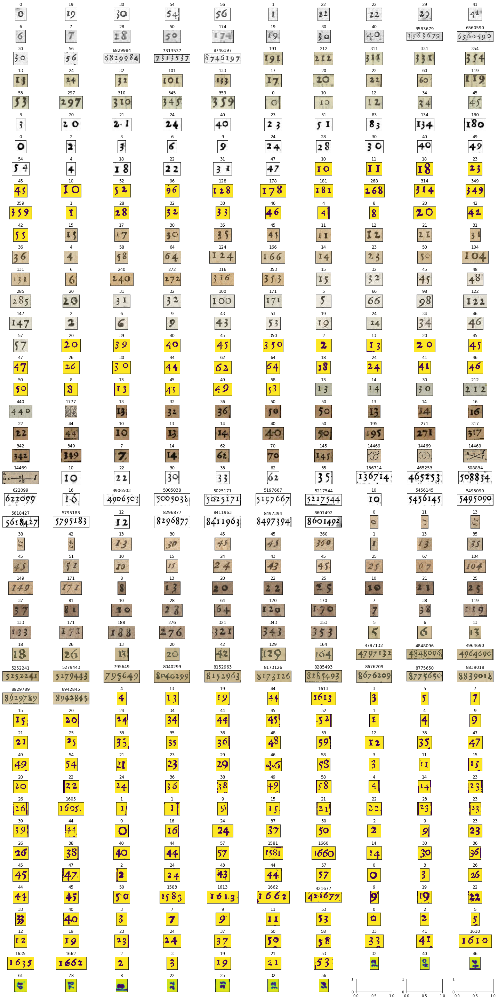

In [8]:
img1 = PIL.Image.open('/home/oeberle/explainable_embeds/presentation/historic_numbers.png')
img1

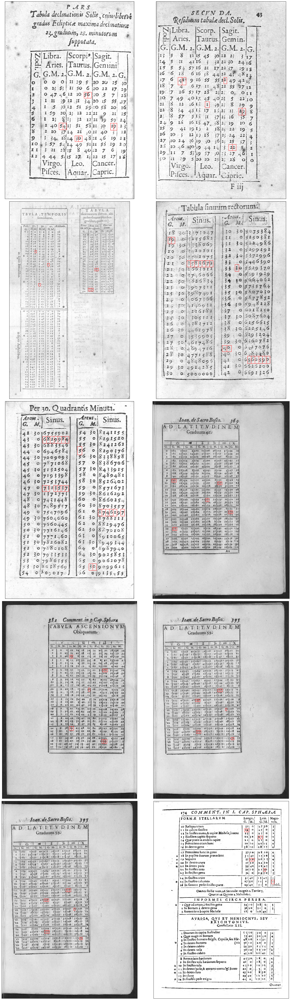

In [7]:
img2 = PIL.Image.open('/home/oeberle/explainable_embeds/presentation/boxsplit.png')
img2

In [14]:
def get_historic_map(X, y, fix, patch=False, extract_patch=False, pad = None):
    
    gaussian_filter = get_gaussian_kernel(13,2,1)
    h0,w0 = X.shape[1], X.shape[2]

    if extract_patch:
        if len(X.shape) ==3:
            X = X.unsqueeze(0)
        bbox = fix.squeeze(0)
        X = X[:,:,bbox[0][1]-pad:bbox[0][1]+bbox[0][3]+pad, bbox[0][0]-pad:bbox[-1][0]+bbox[-1][2]+pad].squeeze(0)

    h,w = X.shape[1], X.shape[2]
    labels = [int(y_.cpu().detach().numpy()) for y_ in y]
    grid_dict = {i:torch.zeros((1,h,w)) for i in range(10)}
        
    k = 0
    if fix.shape[1] > 1:
        fix = fix.squeeze()
    
    for fi in fix:
        fi = fi.squeeze()
        tensor = grid_dict[labels[k]]
        if len(tensor.shape) ==3:
            tensor = tensor      
        else:
            raise
            
        if patch and extract_patch==False:
            tensor[:,int(fi[1]):int(fi[1])+int(fi[3]), int(fi[0]):int(fi[0])+int(fi[2])] = 1.
        elif extract_patch==True:
            fix_ = [np.floor(k*fi[2] + fi[2]/2.)+ pad , np.floor(fi[3]/2.) + pad] 
            tensor[:,int(fix_[1]), int(fix_[0])] = 1.
            mask = torch.zeros_like(tensor)
            mask[:,pad:h-pad, pad:w-pad] = 1.
        else:
            tensor[:,int(fi[1]), int(fi[0])] = 1.
        grid_dict[labels[k]] = tensor
        
        k+=1
          
    grid_dict = {k:gaussian_filter(v.unsqueeze(0)).squeeze(0) for k,v in grid_dict.items()}    
    grid_dict = {k:1000.*v/torch.max(v) if torch.max(v)>0. else v for k,v in grid_dict.items()}

    out = torch.stack([grid_dict[i] for i in range(10)]).squeeze()
    
    if extract_patch:
        return out ,  X, mask
    else:
        return out       

In [62]:

H0,W0  = [],[] 
for phase in ['test', 'train']:
    for images, region, bboxes, labels in dataloaders[phase]:

        X_ = images

        Y, patch, mask = get_historic_map(images[0,:,:,:],labels, bboxes , patch=False, extract_patch=True, pad=0)# for i in range(images.shape[0])]

        hw = list(patch.squeeze().shape)
        H0.append(hw[0])       
        W0.append(hw[1])       


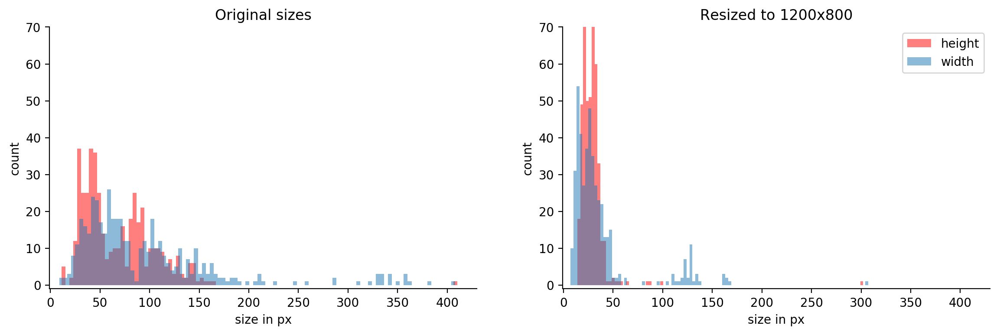

In [72]:

f, ax = plt.subplots(1,2, figsize=(14,4), dpi=200)

ax[0].hist(H0, 100, color='red', label='height', alpha = 0.5)
ax[0].hist(W0, 100,  label='width', alpha = 0.5)

ax[0].set_xlabel('size in px')
ax[0].set_ylabel('count')
ax[0].spines['right'].set_visible(False)
ax[0].spines['top'].set_visible(False)
ax[0].set_title('Original sizes')
ax[0].set_xlim([-1,430])
ax[0].set_ylim([-1,70])

ax[1].hist(H, 100, color='red', label='height', alpha = 0.5)
ax[1].hist(W, 100,  label='width', alpha = 0.5)

ax[1].set_xlabel('size in px')
ax[1].set_ylabel('count')
ax[1].spines['right'].set_visible(False)
ax[1].spines['top'].set_visible(False)
ax[1].set_title('Resized to 1200x800')
ax[1].set_xlim([-1,430])
ax[1].set_ylim([-1,70])


plt.legend()
plt.show()

In [6]:
model  = CanvasModelBig()
modeldir = '/home/oeberle/explainable_embeds/experiments/06052019_mnist_canvas/canvasmodel.pt'
model.load_state_dict(torch.load(modeldir))

In [ ]:
from torch.optim import lr_scheduler
#params = list(e1.parameters()) + list(e2.parameters()) + list(el1.parameters())+list( el2.parameters()) + list(eb1.parameters()) +   list(eb1.parameters()) + list(autoencoder.parameters())
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
gaussian_filter = get_gaussian_kernel(13,4,1)


model.cuda()
params = model.parameters()                                         
criterion = torch.nn.MSELoss()

optimizer = torch.optim.SGD(list(model.parameters()), lr=0.001, momentum=0.9)
optimizer = torch.optim.Adam(model.parameters(), lr = 0.001)
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

import time
model_trained, res = train_model(model, criterion, optimizer,exp_lr_scheduler, num_epochs=100)

save_dir = '/home/oeberle/explainable_embeds/experiments/06052019_mnist_canvas/'
torch.save(model_trained.state_dict(), save_dir + 'historic_tuned_canvasmodel_patches_pad_30_not_masked.pt')

Epoch 0/99
----------
torch.Size([10, 145, 197]) torch.Size([1, 10, 145, 197])
torch.Size([10, 84, 70]) torch.Size([1, 10, 84, 70])
torch.Size([10, 90, 75]) torch.Size([1, 10, 90, 75])
torch.Size([10, 88, 83]) torch.Size([1, 10, 88, 83])
torch.Size([10, 97, 169]) torch.Size([1, 10, 97, 169])
torch.Size([10, 125, 226]) torch.Size([1, 10, 125, 226])
torch.Size([10, 82, 84]) torch.Size([1, 10, 82, 84])
torch.Size([10, 96, 193]) torch.Size([1, 10, 96, 193])
torch.Size([10, 93, 69]) torch.Size([1, 10, 93, 69])
torch.Size([10, 91, 90]) torch.Size([1, 10, 91, 90])
torch.Size([10, 111, 76]) torch.Size([1, 10, 111, 76])
torch.Size([10, 91, 75]) torch.Size([1, 10, 91, 75])
torch.Size([10, 100, 98]) torch.Size([1, 10, 100, 98])
torch.Size([10, 82, 80]) torch.Size([1, 10, 82, 80])
torch.Size([10, 84, 74]) torch.Size([1, 10, 84, 74])
torch.Size([10, 89, 70]) torch.Size([1, 10, 89, 70])
torch.Size([10, 90, 112]) torch.Size([1, 10, 90, 112])
torch.Size([10, 90, 188]) torch.Size([1, 10, 90, 188])
torc

torch.Size([10, 92, 76]) torch.Size([1, 10, 92, 76])
torch.Size([10, 91, 77]) torch.Size([1, 10, 91, 77])
torch.Size([10, 88, 84]) torch.Size([1, 10, 88, 84])
torch.Size([10, 78, 87]) torch.Size([1, 10, 78, 87])
torch.Size([10, 92, 83]) torch.Size([1, 10, 92, 83])
torch.Size([10, 74, 81]) torch.Size([1, 10, 74, 81])
torch.Size([10, 92, 76]) torch.Size([1, 10, 92, 76])
torch.Size([10, 102, 100]) torch.Size([1, 10, 102, 100])
torch.Size([10, 83, 90]) torch.Size([1, 10, 83, 90])
torch.Size([10, 82, 99]) torch.Size([1, 10, 82, 99])
torch.Size([10, 94, 91]) torch.Size([1, 10, 94, 91])
torch.Size([10, 93, 76]) torch.Size([1, 10, 93, 76])
torch.Size([10, 82, 84]) torch.Size([1, 10, 82, 84])
torch.Size([10, 87, 92]) torch.Size([1, 10, 87, 92])
torch.Size([10, 88, 77]) torch.Size([1, 10, 88, 77])
torch.Size([10, 91, 77]) torch.Size([1, 10, 91, 77])
torch.Size([10, 91, 98]) torch.Size([1, 10, 91, 98])
torch.Size([10, 79, 84]) torch.Size([1, 10, 79, 84])
torch.Size([10, 96, 103]) torch.Size([1, 1

torch.Size([10, 92, 71]) torch.Size([1, 10, 92, 71])
torch.Size([10, 89, 93]) torch.Size([1, 10, 89, 93])
torch.Size([10, 84, 103]) torch.Size([1, 10, 84, 103])
torch.Size([10, 88, 77]) torch.Size([1, 10, 88, 77])
torch.Size([10, 87, 84]) torch.Size([1, 10, 87, 84])
torch.Size([10, 92, 99]) torch.Size([1, 10, 92, 99])
torch.Size([10, 99, 71]) torch.Size([1, 10, 99, 71])
torch.Size([10, 83, 75]) torch.Size([1, 10, 83, 75])
torch.Size([10, 90, 93]) torch.Size([1, 10, 90, 93])
torch.Size([10, 99, 96]) torch.Size([1, 10, 99, 96])
torch.Size([10, 90, 91]) torch.Size([1, 10, 90, 91])
torch.Size([10, 85, 76]) torch.Size([1, 10, 85, 76])
torch.Size([10, 92, 82]) torch.Size([1, 10, 92, 82])
torch.Size([10, 87, 74]) torch.Size([1, 10, 87, 74])
torch.Size([10, 96, 181]) torch.Size([1, 10, 96, 181])
torch.Size([10, 80, 70]) torch.Size([1, 10, 80, 70])
torch.Size([10, 83, 96]) torch.Size([1, 10, 83, 96])
torch.Size([10, 75, 94]) torch.Size([1, 10, 75, 94])
torch.Size([10, 97, 98]) torch.Size([1, 10

torch.Size([10, 83, 84]) torch.Size([1, 10, 83, 84])
torch.Size([10, 80, 85]) torch.Size([1, 10, 80, 85])
torch.Size([10, 77, 80]) torch.Size([1, 10, 77, 80])
torch.Size([10, 97, 86]) torch.Size([1, 10, 97, 86])
torch.Size([10, 92, 83]) torch.Size([1, 10, 92, 83])
torch.Size([10, 92, 121]) torch.Size([1, 10, 92, 121])
torch.Size([10, 74, 85]) torch.Size([1, 10, 74, 85])
torch.Size([10, 82, 99]) torch.Size([1, 10, 82, 99])
torch.Size([10, 80, 85]) torch.Size([1, 10, 80, 85])
torch.Size([10, 88, 75]) torch.Size([1, 10, 88, 75])
torch.Size([10, 97, 169]) torch.Size([1, 10, 97, 169])
torch.Size([10, 85, 76]) torch.Size([1, 10, 85, 76])
torch.Size([10, 91, 90]) torch.Size([1, 10, 91, 90])
torch.Size([10, 83, 70]) torch.Size([1, 10, 83, 70])
torch.Size([10, 86, 93]) torch.Size([1, 10, 86, 93])
torch.Size([10, 87, 75]) torch.Size([1, 10, 87, 75])
torch.Size([10, 82, 85]) torch.Size([1, 10, 82, 85])
torch.Size([10, 84, 97]) torch.Size([1, 10, 84, 97])
torch.Size([10, 81, 106]) torch.Size([1, 1

torch.Size([10, 92, 87]) torch.Size([1, 10, 92, 87])
torch.Size([10, 91, 77]) torch.Size([1, 10, 91, 77])
torch.Size([10, 78, 87]) torch.Size([1, 10, 78, 87])
torch.Size([10, 90, 86]) torch.Size([1, 10, 90, 86])
torch.Size([10, 90, 74]) torch.Size([1, 10, 90, 74])
torch.Size([10, 92, 70]) torch.Size([1, 10, 92, 70])
torch.Size([10, 78, 75]) torch.Size([1, 10, 78, 75])
torch.Size([10, 84, 106]) torch.Size([1, 10, 84, 106])
torch.Size([10, 107, 108]) torch.Size([1, 10, 107, 108])
torch.Size([10, 95, 189]) torch.Size([1, 10, 95, 189])
torch.Size([10, 87, 99]) torch.Size([1, 10, 87, 99])
torch.Size([10, 85, 67]) torch.Size([1, 10, 85, 67])
torch.Size([10, 88, 84]) torch.Size([1, 10, 88, 84])
torch.Size([10, 87, 74]) torch.Size([1, 10, 87, 74])
torch.Size([10, 80, 73]) torch.Size([1, 10, 80, 73])
torch.Size([10, 82, 88]) torch.Size([1, 10, 82, 88])
torch.Size([10, 90, 77]) torch.Size([1, 10, 90, 77])
torch.Size([10, 90, 102]) torch.Size([1, 10, 90, 102])
torch.Size([10, 96, 193]) torch.Size

torch.Size([10, 84, 94]) torch.Size([1, 10, 84, 94])
torch.Size([10, 80, 87]) torch.Size([1, 10, 80, 87])
torch.Size([10, 85, 68]) torch.Size([1, 10, 85, 68])
torch.Size([10, 88, 75]) torch.Size([1, 10, 88, 75])
torch.Size([10, 82, 83]) torch.Size([1, 10, 82, 83])
torch.Size([10, 87, 74]) torch.Size([1, 10, 87, 74])
torch.Size([10, 93, 164]) torch.Size([1, 10, 93, 164])
torch.Size([10, 90, 188]) torch.Size([1, 10, 90, 188])
torch.Size([10, 86, 72]) torch.Size([1, 10, 86, 72])
torch.Size([10, 93, 69]) torch.Size([1, 10, 93, 69])
torch.Size([10, 93, 187]) torch.Size([1, 10, 93, 187])
torch.Size([10, 80, 79]) torch.Size([1, 10, 80, 79])
torch.Size([10, 92, 82]) torch.Size([1, 10, 92, 82])
torch.Size([10, 85, 84]) torch.Size([1, 10, 85, 84])
torch.Size([10, 91, 90]) torch.Size([1, 10, 91, 90])
torch.Size([10, 90, 78]) torch.Size([1, 10, 90, 78])
torch.Size([10, 90, 75]) torch.Size([1, 10, 90, 75])
torch.Size([10, 77, 86]) torch.Size([1, 10, 77, 86])
torch.Size([10, 100, 187]) torch.Size([1

torch.Size([10, 79, 84]) torch.Size([1, 10, 79, 84])
torch.Size([10, 94, 90]) torch.Size([1, 10, 94, 90])
torch.Size([10, 87, 76]) torch.Size([1, 10, 87, 76])
torch.Size([10, 83, 97]) torch.Size([1, 10, 83, 97])
torch.Size([10, 81, 88]) torch.Size([1, 10, 81, 88])
torch.Size([10, 96, 181]) torch.Size([1, 10, 96, 181])
torch.Size([10, 101, 223]) torch.Size([1, 10, 101, 223])
torch.Size([10, 88, 93]) torch.Size([1, 10, 88, 93])
torch.Size([10, 81, 95]) torch.Size([1, 10, 81, 95])
torch.Size([10, 80, 81]) torch.Size([1, 10, 80, 81])
torch.Size([10, 92, 87]) torch.Size([1, 10, 92, 87])
torch.Size([10, 98, 106]) torch.Size([1, 10, 98, 106])
torch.Size([10, 87, 84]) torch.Size([1, 10, 87, 84])
torch.Size([10, 88, 105]) torch.Size([1, 10, 88, 105])
torch.Size([10, 80, 80]) torch.Size([1, 10, 80, 80])
torch.Size([10, 83, 84]) torch.Size([1, 10, 83, 84])
torch.Size([10, 90, 74]) torch.Size([1, 10, 90, 74])
torch.Size([10, 83, 71]) torch.Size([1, 10, 83, 71])
torch.Size([10, 125, 226]) torch.Siz

torch.Size([10, 81, 93]) torch.Size([1, 10, 81, 93])
torch.Size([10, 83, 103]) torch.Size([1, 10, 83, 103])
torch.Size([10, 92, 92]) torch.Size([1, 10, 92, 92])
torch.Size([10, 79, 87]) torch.Size([1, 10, 79, 87])
torch.Size([10, 86, 102]) torch.Size([1, 10, 86, 102])
torch.Size([10, 84, 74]) torch.Size([1, 10, 84, 74])
torch.Size([10, 96, 193]) torch.Size([1, 10, 96, 193])
torch.Size([10, 95, 90]) torch.Size([1, 10, 95, 90])
torch.Size([10, 92, 87]) torch.Size([1, 10, 92, 87])
torch.Size([10, 90, 99]) torch.Size([1, 10, 90, 99])
torch.Size([10, 83, 90]) torch.Size([1, 10, 83, 90])
torch.Size([10, 93, 99]) torch.Size([1, 10, 93, 99])
torch.Size([10, 92, 76]) torch.Size([1, 10, 92, 76])
torch.Size([10, 78, 79]) torch.Size([1, 10, 78, 79])
torch.Size([10, 90, 102]) torch.Size([1, 10, 90, 102])
torch.Size([10, 78, 80]) torch.Size([1, 10, 78, 80])
torch.Size([10, 75, 85]) torch.Size([1, 10, 75, 85])
torch.Size([10, 75, 81]) torch.Size([1, 10, 75, 81])
torch.Size([10, 84, 68]) torch.Size([1

torch.Size([10, 88, 77]) torch.Size([1, 10, 88, 77])
torch.Size([10, 84, 103]) torch.Size([1, 10, 84, 103])
torch.Size([10, 91, 75]) torch.Size([1, 10, 91, 75])
torch.Size([10, 77, 80]) torch.Size([1, 10, 77, 80])
torch.Size([10, 75, 78]) torch.Size([1, 10, 75, 78])
torch.Size([10, 74, 81]) torch.Size([1, 10, 74, 81])
torch.Size([10, 96, 193]) torch.Size([1, 10, 96, 193])
torch.Size([10, 91, 79]) torch.Size([1, 10, 91, 79])
torch.Size([10, 87, 75]) torch.Size([1, 10, 87, 75])
torch.Size([10, 80, 85]) torch.Size([1, 10, 80, 85])
torch.Size([10, 89, 68]) torch.Size([1, 10, 89, 68])
torch.Size([10, 83, 88]) torch.Size([1, 10, 83, 88])
torch.Size([10, 81, 85]) torch.Size([1, 10, 81, 85])
torch.Size([10, 92, 82]) torch.Size([1, 10, 92, 82])
torch.Size([10, 90, 77]) torch.Size([1, 10, 90, 77])
torch.Size([10, 83, 87]) torch.Size([1, 10, 83, 87])
torch.Size([10, 80, 80]) torch.Size([1, 10, 80, 80])
torch.Size([10, 93, 78]) torch.Size([1, 10, 93, 78])
torch.Size([10, 79, 85]) torch.Size([1, 10

torch.Size([10, 80, 84]) torch.Size([1, 10, 80, 84])
torch.Size([10, 87, 92]) torch.Size([1, 10, 87, 92])
torch.Size([10, 101, 103]) torch.Size([1, 10, 101, 103])
torch.Size([10, 86, 93]) torch.Size([1, 10, 86, 93])
torch.Size([10, 81, 85]) torch.Size([1, 10, 81, 85])
torch.Size([10, 114, 74]) torch.Size([1, 10, 114, 74])
torch.Size([10, 81, 106]) torch.Size([1, 10, 81, 106])
torch.Size([10, 77, 80]) torch.Size([1, 10, 77, 80])
torch.Size([10, 92, 77]) torch.Size([1, 10, 92, 77])
torch.Size([10, 89, 101]) torch.Size([1, 10, 89, 101])
torch.Size([10, 89, 70]) torch.Size([1, 10, 89, 70])
torch.Size([10, 80, 79]) torch.Size([1, 10, 80, 79])
torch.Size([10, 82, 84]) torch.Size([1, 10, 82, 84])
torch.Size([10, 92, 89]) torch.Size([1, 10, 92, 89])
torch.Size([10, 81, 95]) torch.Size([1, 10, 81, 95])
torch.Size([10, 83, 93]) torch.Size([1, 10, 83, 93])
torch.Size([10, 93, 69]) torch.Size([1, 10, 93, 69])
torch.Size([10, 79, 79]) torch.Size([1, 10, 79, 79])
torch.Size([10, 78, 97]) torch.Size(

torch.Size([10, 90, 86]) torch.Size([1, 10, 90, 86])
torch.Size([10, 92, 182]) torch.Size([1, 10, 92, 182])
torch.Size([10, 80, 89]) torch.Size([1, 10, 80, 89])
torch.Size([10, 92, 75]) torch.Size([1, 10, 92, 75])
torch.Size([10, 81, 81]) torch.Size([1, 10, 81, 81])
torch.Size([10, 81, 94]) torch.Size([1, 10, 81, 94])
torch.Size([10, 78, 81]) torch.Size([1, 10, 78, 81])
torch.Size([10, 91, 90]) torch.Size([1, 10, 91, 90])
torch.Size([10, 100, 187]) torch.Size([1, 10, 100, 187])
torch.Size([10, 95, 74]) torch.Size([1, 10, 95, 74])
torch.Size([10, 77, 80]) torch.Size([1, 10, 77, 80])
torch.Size([10, 84, 74]) torch.Size([1, 10, 84, 74])
torch.Size([10, 85, 84]) torch.Size([1, 10, 85, 84])
torch.Size([10, 92, 99]) torch.Size([1, 10, 92, 99])
torch.Size([10, 91, 72]) torch.Size([1, 10, 91, 72])
torch.Size([10, 98, 182]) torch.Size([1, 10, 98, 182])
torch.Size([10, 92, 111]) torch.Size([1, 10, 92, 111])
torch.Size([10, 93, 92]) torch.Size([1, 10, 93, 92])
torch.Size([10, 95, 90]) torch.Size(

torch.Size([10, 75, 83]) torch.Size([1, 10, 75, 83])
torch.Size([10, 93, 181]) torch.Size([1, 10, 93, 181])
torch.Size([10, 82, 84]) torch.Size([1, 10, 82, 84])
torch.Size([10, 80, 85]) torch.Size([1, 10, 80, 85])
torch.Size([10, 83, 90]) torch.Size([1, 10, 83, 90])
torch.Size([10, 87, 94]) torch.Size([1, 10, 87, 94])
torch.Size([10, 82, 80]) torch.Size([1, 10, 82, 80])
torch.Size([10, 95, 91]) torch.Size([1, 10, 95, 91])
torch.Size([10, 96, 185]) torch.Size([1, 10, 96, 185])
torch.Size([10, 92, 111]) torch.Size([1, 10, 92, 111])
torch.Size([10, 83, 88]) torch.Size([1, 10, 83, 88])
torch.Size([10, 85, 67]) torch.Size([1, 10, 85, 67])
torch.Size([10, 84, 68]) torch.Size([1, 10, 84, 68])
torch.Size([10, 89, 76]) torch.Size([1, 10, 89, 76])
torch.Size([10, 91, 73]) torch.Size([1, 10, 91, 73])
torch.Size([10, 79, 84]) torch.Size([1, 10, 79, 84])
torch.Size([10, 101, 106]) torch.Size([1, 10, 101, 106])
torch.Size([10, 89, 101]) torch.Size([1, 10, 89, 101])
torch.Size([10, 98, 182]) torch.Si

In [100]:
with torch.no_grad():
    phase = 'test'
    for images, region, bboxes, labels in dataloaders[phase]:

        X_ = images

        Y, patch,_ = get_historic_map(images[0,:,:,:],labels, bboxes , patch=False, extract_patch=True, pad=10)# for i in range(images.shape[0])]

        A = X_.cpu().detach().numpy()

        B = Y.cpu().detach().numpy()



        inputs = X_.to(device)

        y_map = Y.to(device)
        
        break

torch.Size([1, 1, 42, 24])


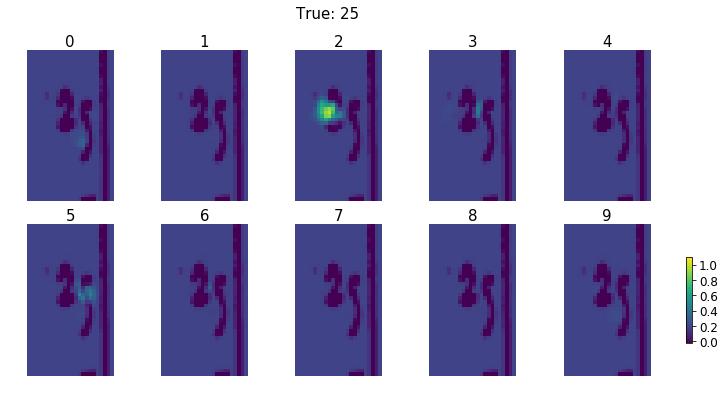

torch.Size([1, 1, 48, 131])


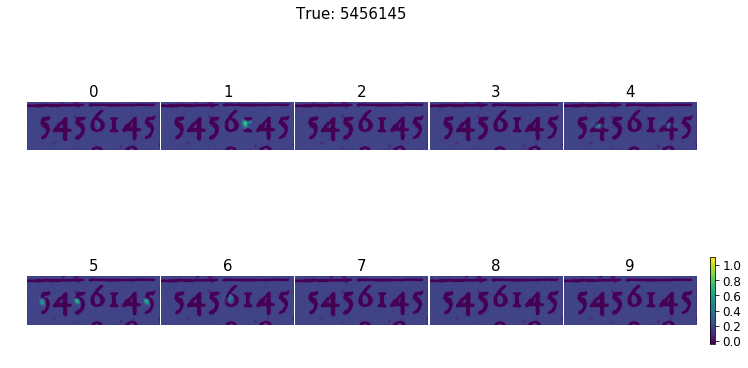

torch.Size([1, 1, 26, 38])


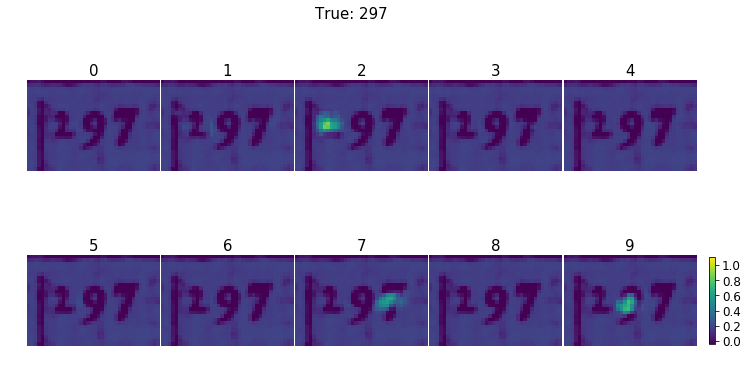

torch.Size([1, 1, 41, 27])


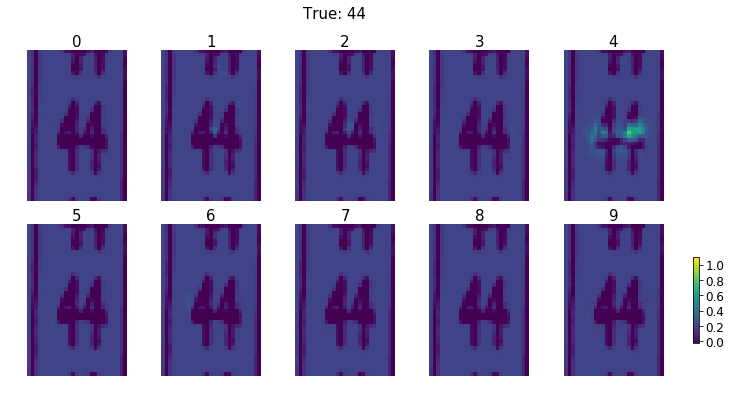

torch.Size([1, 1, 39, 43])


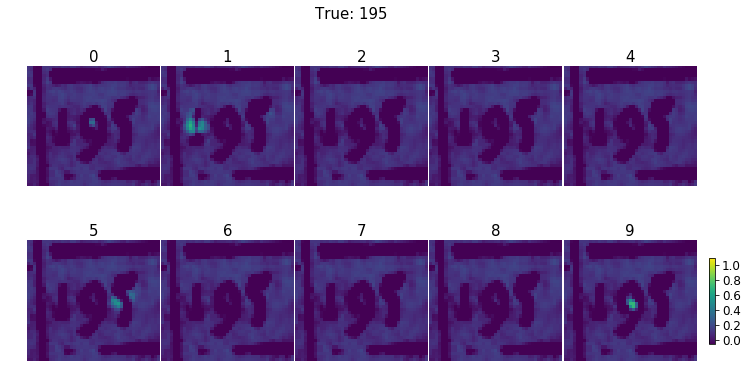

RuntimeError: No active exception to reraise

In [1085]:
k = 0
with torch.no_grad():
    phase = 'test'
    for images, region, bboxes, labels in dataloaders[phase]:

        Y, patch, _ = get_historic_map(images[0,:,:,:],labels, bboxes , patch=False, extract_patch=True, pad=5)# for i in range(images.shape[0])]
        patch = patch.unsqueeze(0)
        print(patch.shape)

        X_ = patch - torch.mean(patch, dim=(2,3))
        X_page = images - torch.mean(images, dim=(2,3))

        inputs = X_.to(device)
        y_map = Y.to(device)

        O = model(X_.cuda())
        O_page = model(X_page.cuda())

        visualize_prediction(O, patch)   
#        visualize_prediction(O_page, X_page)   

        k+=1
    
        if k == 5:
            raise

torch.Size([1, 1, 41, 27])


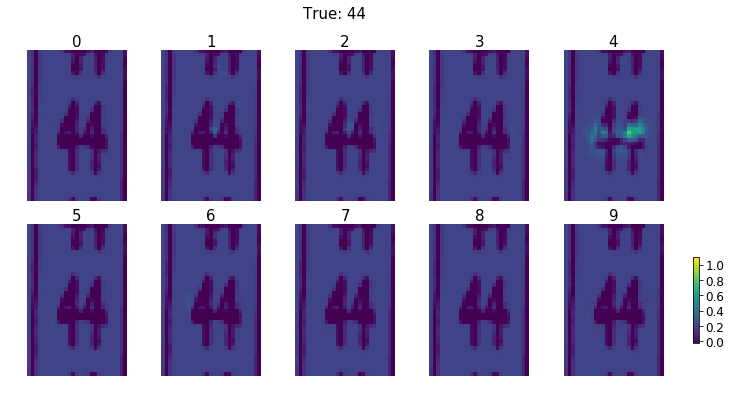

torch.Size([1, 1, 47, 64])


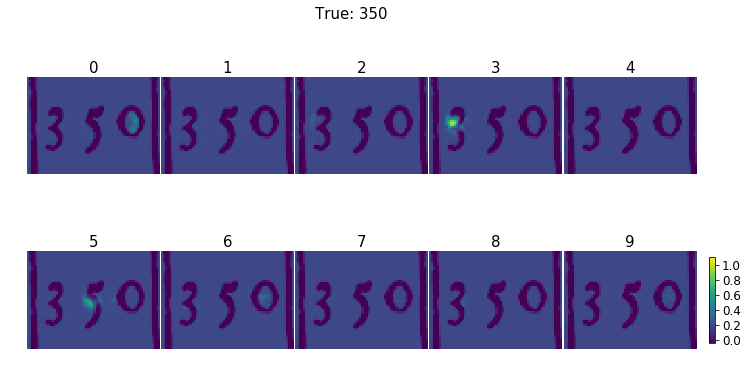

torch.Size([1, 1, 39, 43])


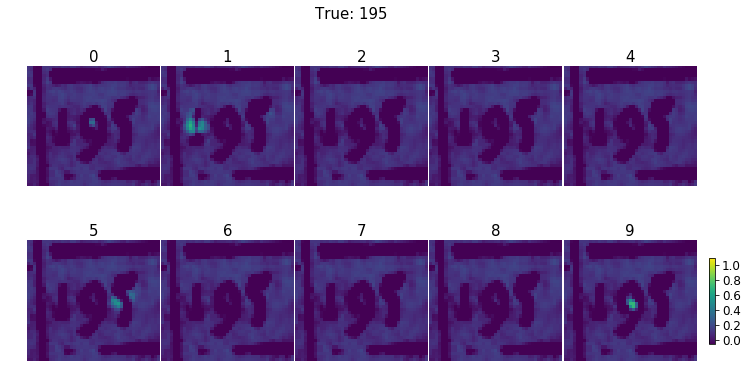

torch.Size([1, 1, 37, 56])


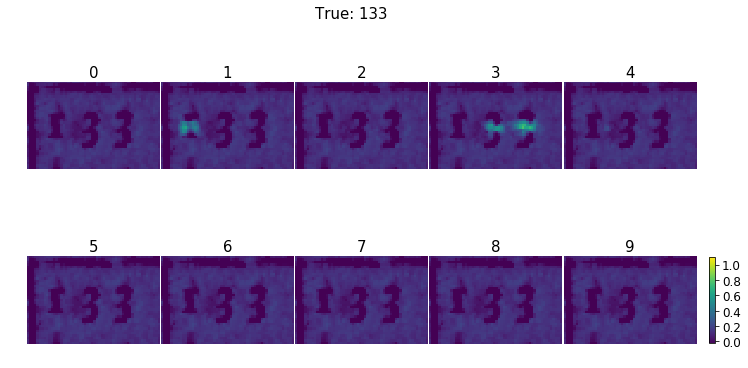

torch.Size([1, 1, 48, 46])


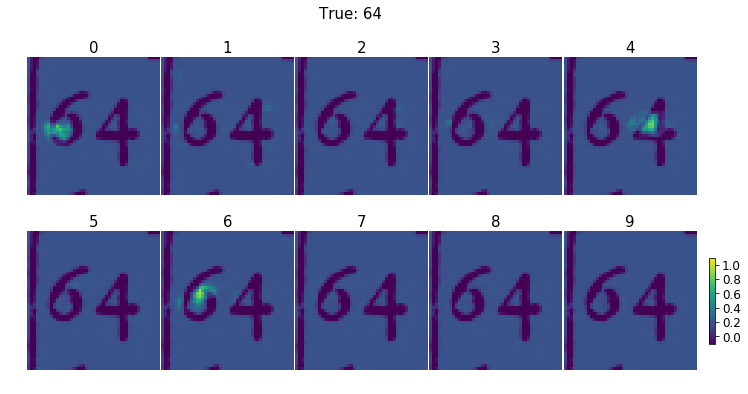

RuntimeError: No active exception to reraise

In [911]:
k = 0
with torch.no_grad():
    phase = 'test'
    for images, region, bboxes, labels in dataloaders[phase]:

        Y, patch = get_historic_map(images[0,:,:,:],labels, bboxes , patch=False, extract_patch=True, pad=5)# for i in range(images.shape[0])]
        patch = patch.unsqueeze(0)
        print(patch.shape)

        X_ = patch - torch.mean(patch, dim=(2,3))
        X_page = images - torch.mean(images, dim=(2,3))

        inputs = X_.to(device)
        y_map = Y.to(device)

        O = model_trained(X_.cuda())
        O_page = model_trained(X_page.cuda())

        visualize_prediction(O, patch)   
#        visualize_prediction(O_page, X_page)   

        k+=1
    
        if k == 5:
            break
        

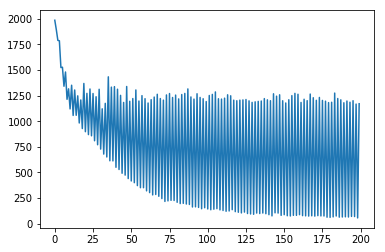

In [952]:
plt.plot(res['train']['loss'])

# Full page predictions

### Example 1 - Text + numbers

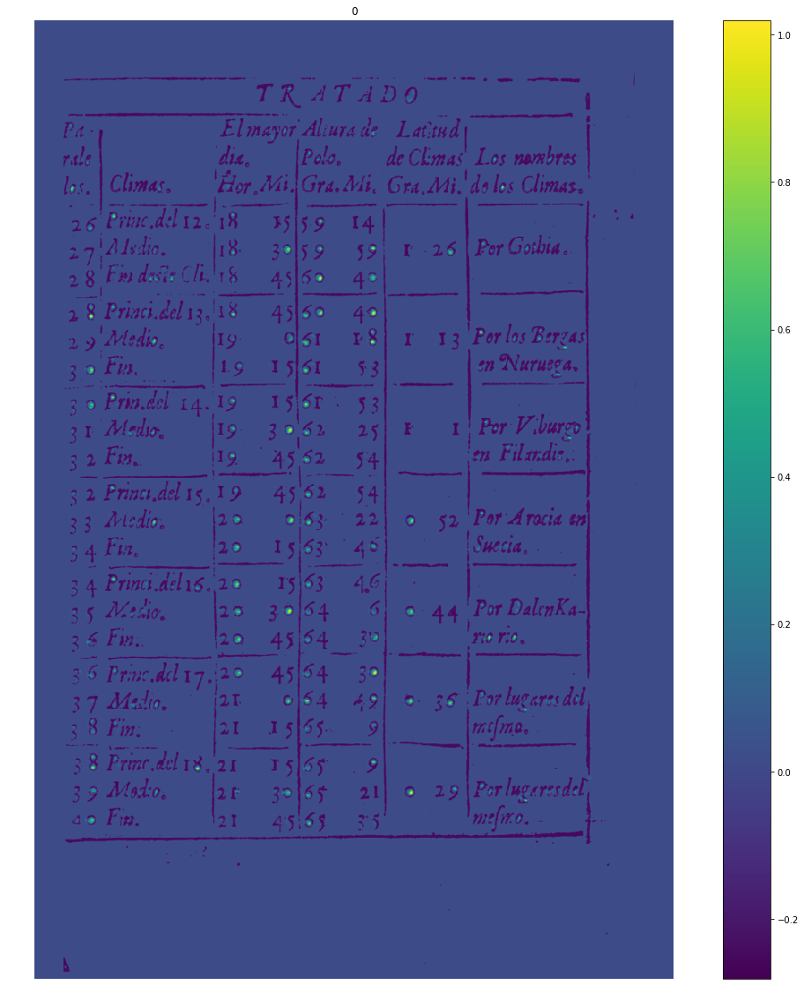

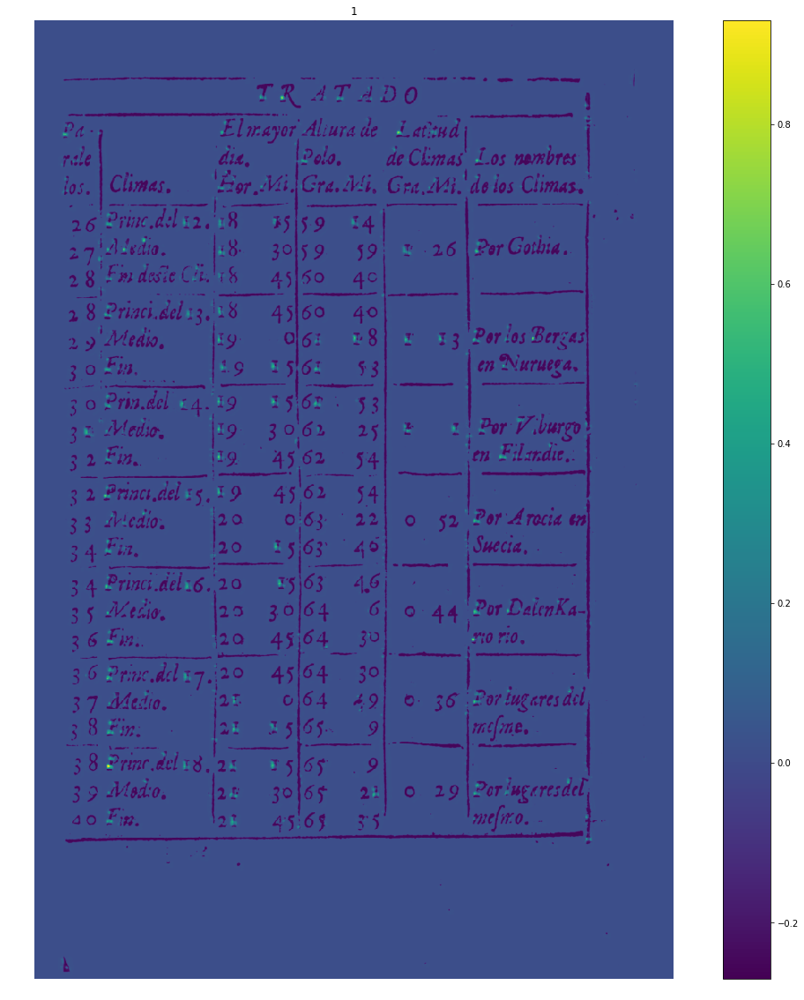

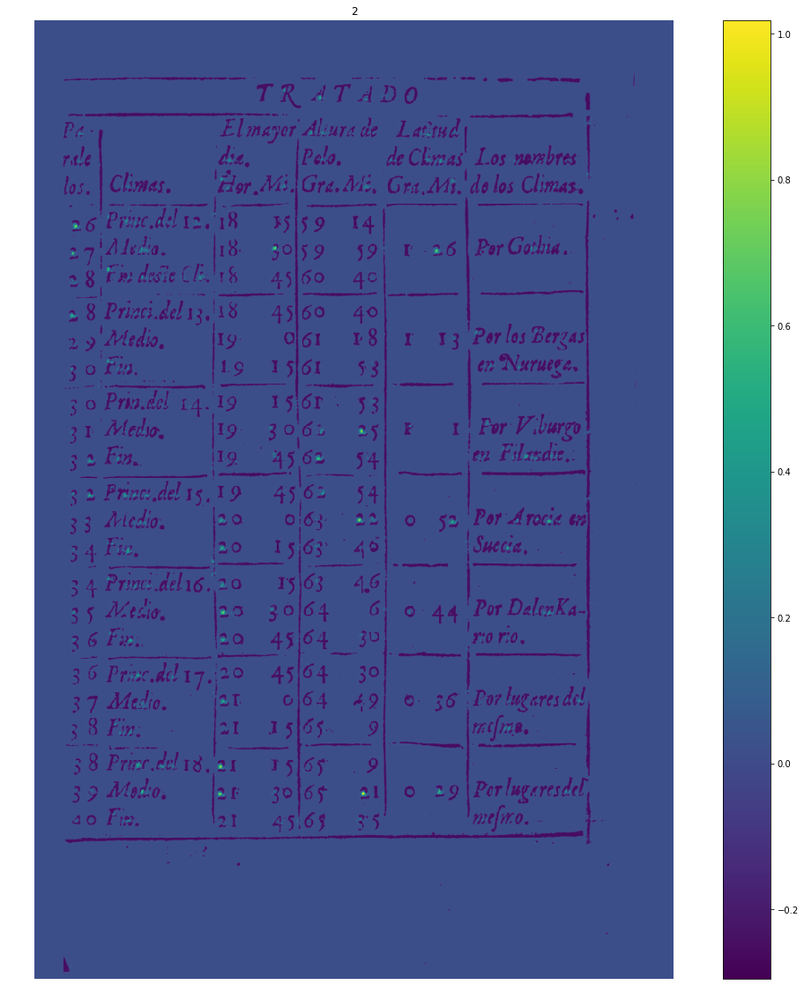

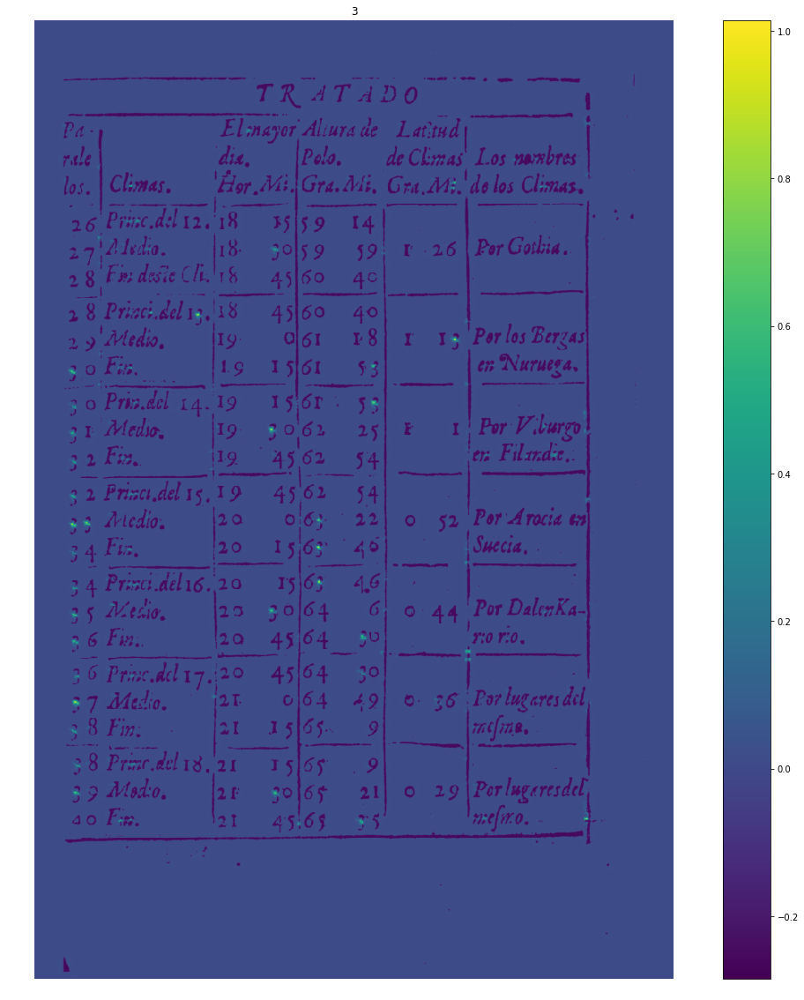

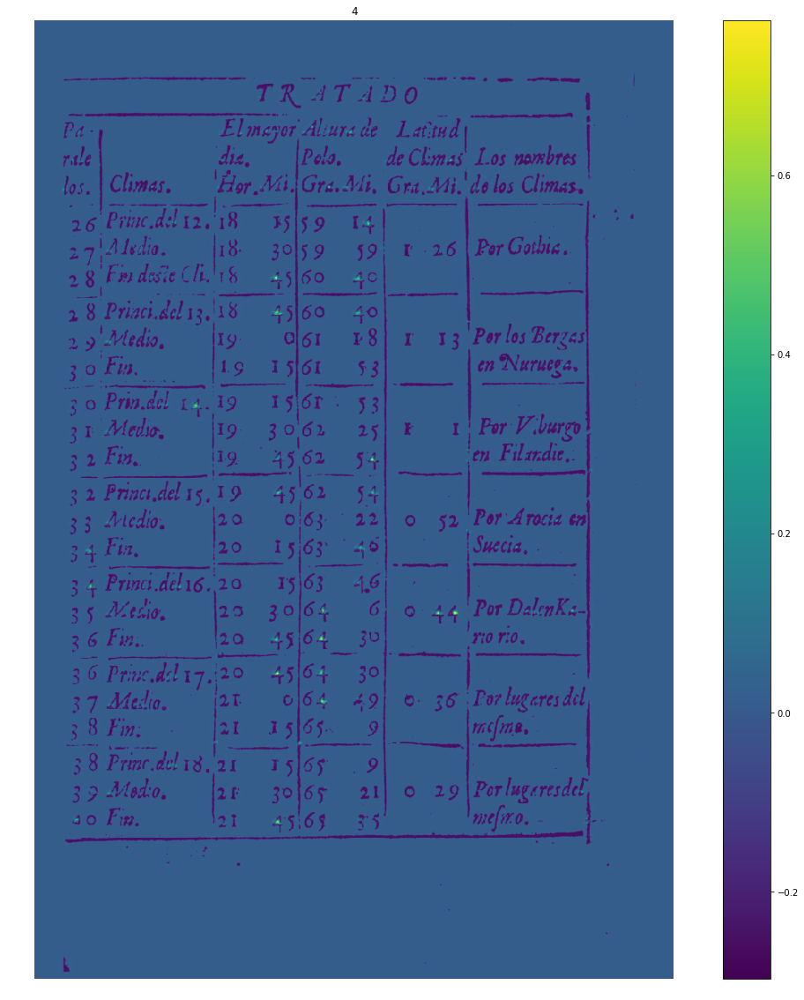

...

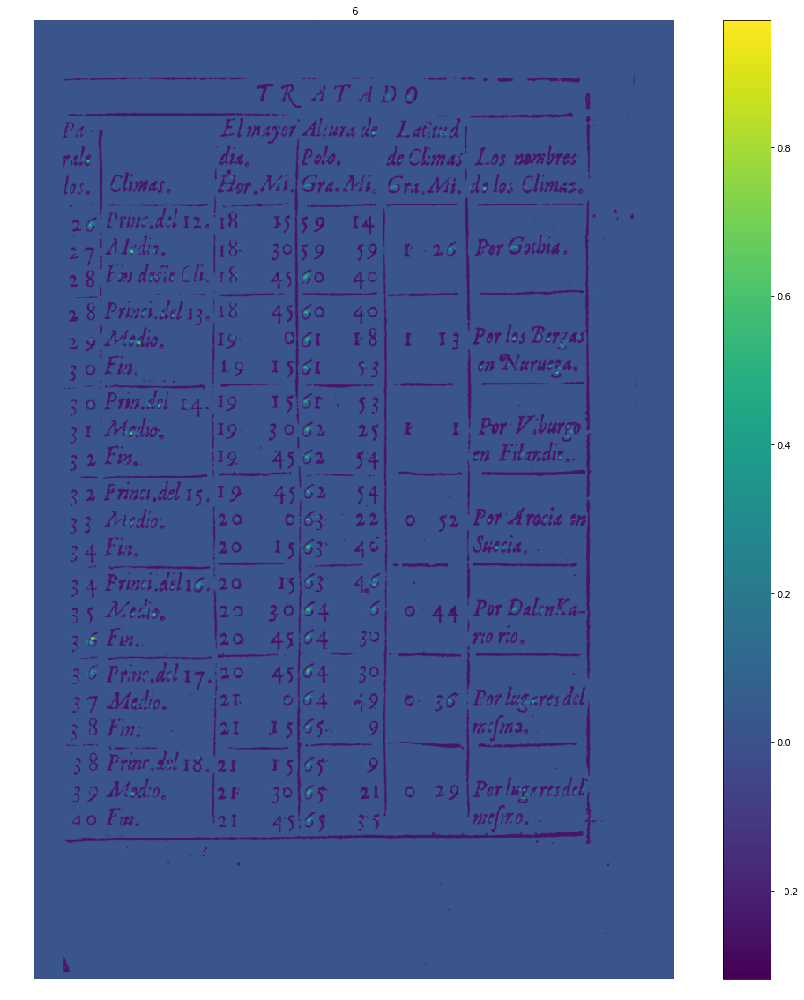

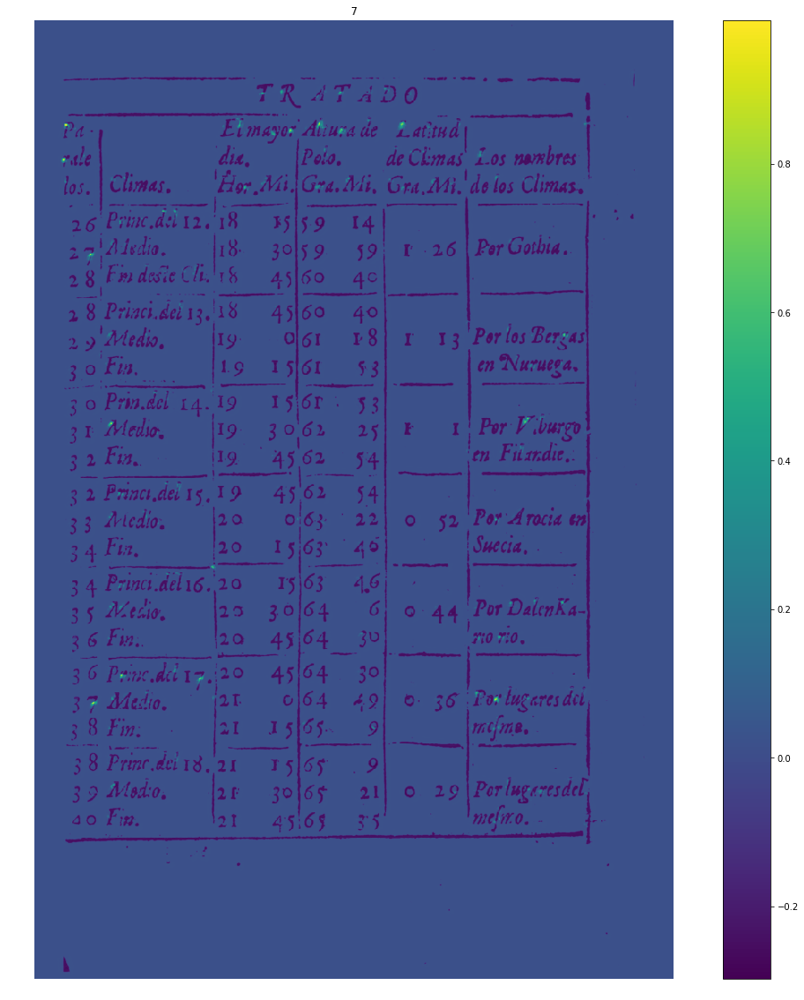

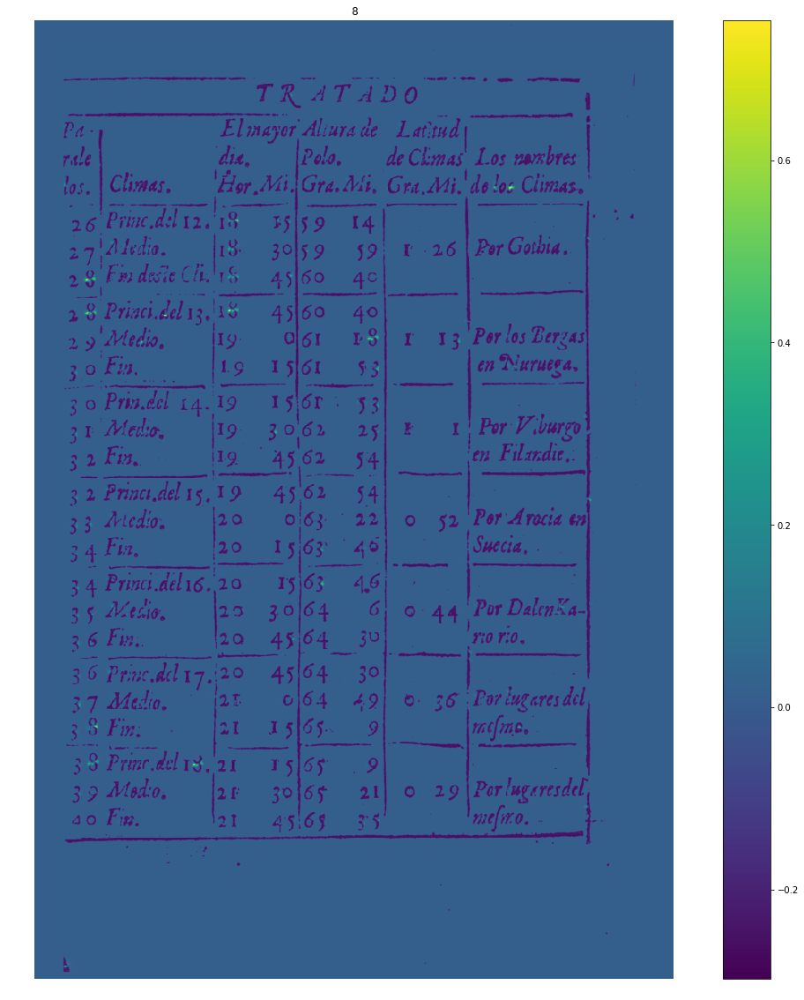

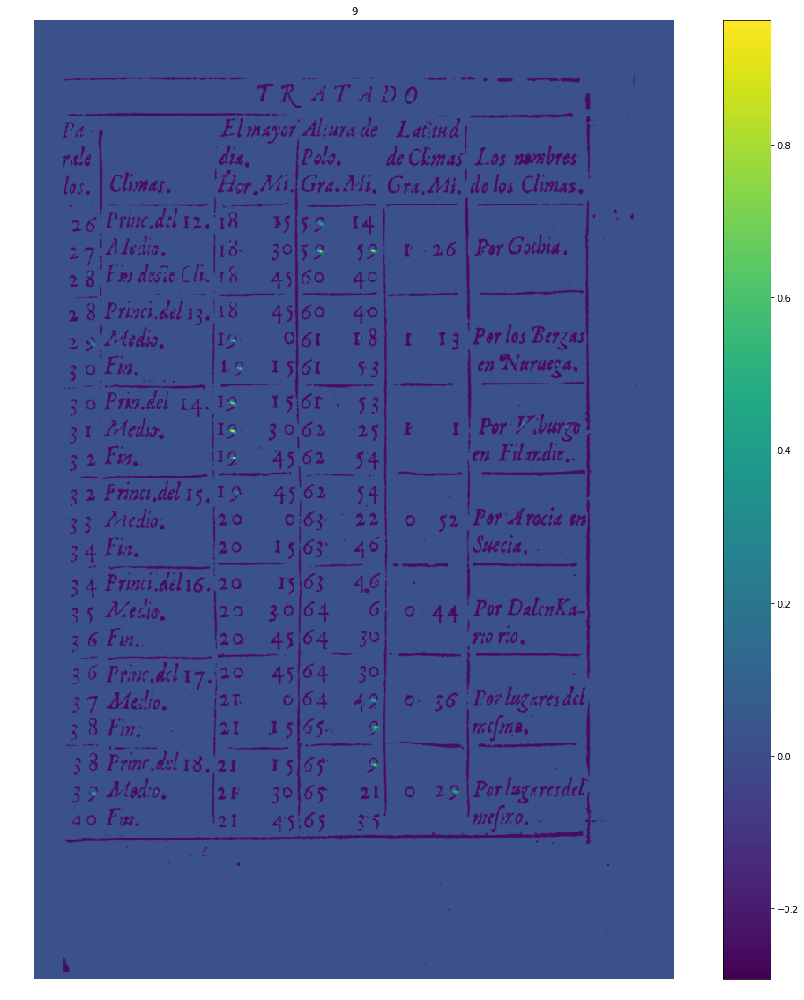

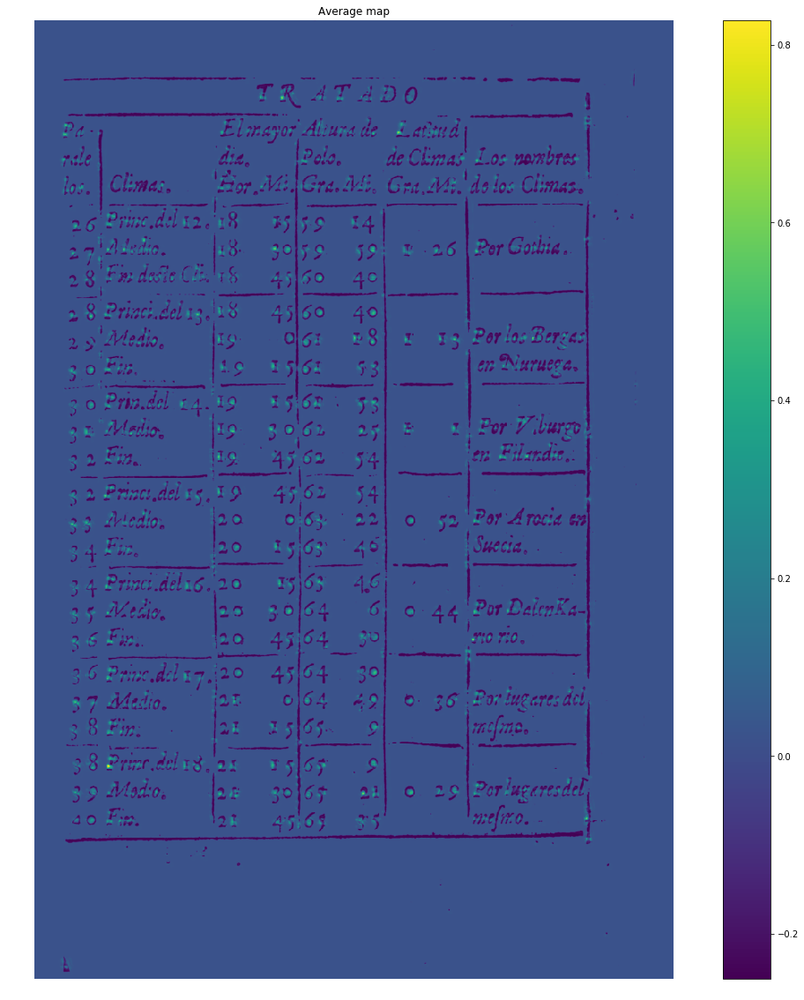

In [950]:
I = X_page.squeeze()/X_page.max()
if True:
    for i in range(10):
        plt.figure(figsize=(20,20))
        O_ = O_page[0,i,:,:].detach().cpu().squeeze()
        plt.imshow(0.02*I/I.max() + O_/O_.max())
        plt.title(i)
        plt.axis('off')
        plt.colorbar()
        plt.show()

        
O_list = [O_page[0,i,:,:].detach().cpu().squeeze() for i in range(10)]
O_avg = O_page.squeeze().mean(dim=0)
B =  O_avg/O_avg.max()
plt.figure(figsize=(20,20))
plt.imshow(0.02*I/I.max() + 0.9*B.cpu())
plt.title('Average map')
plt.axis('off')
plt.colorbar()
plt.show()
    


### Example 2 - Numbers

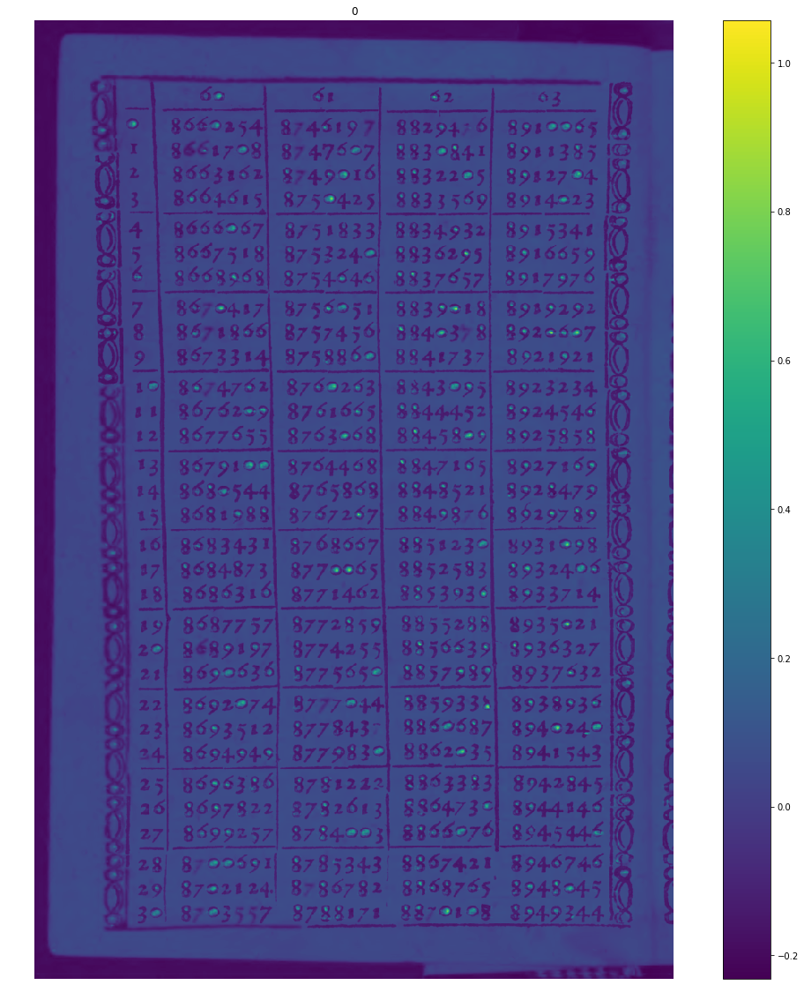

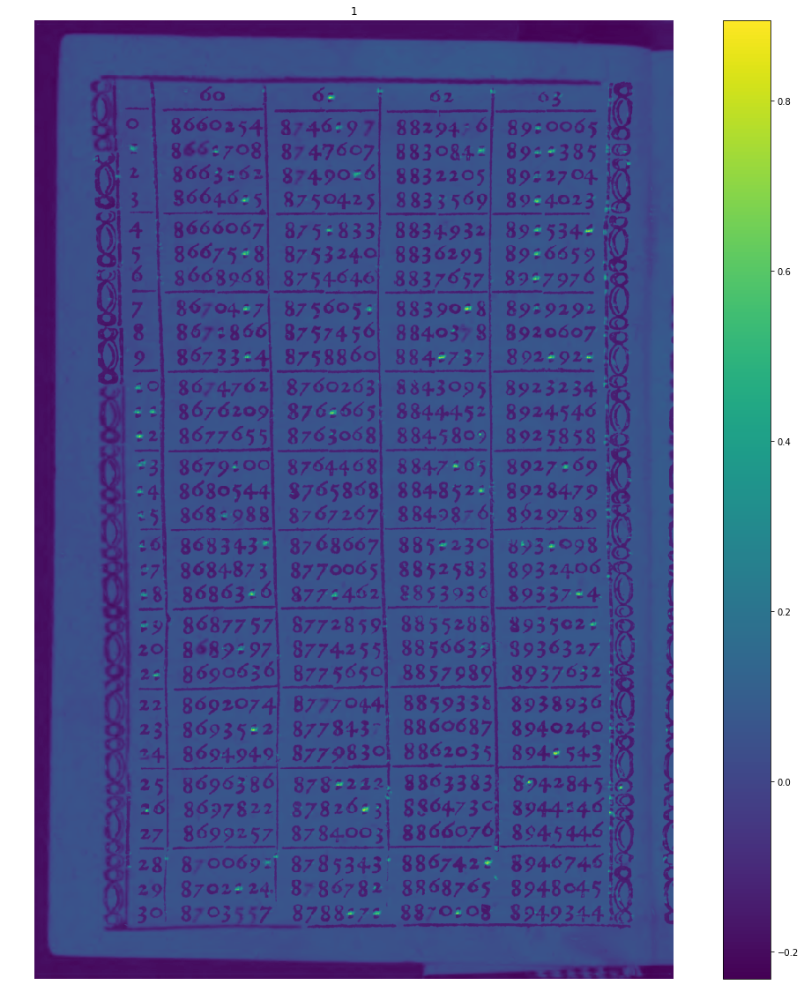

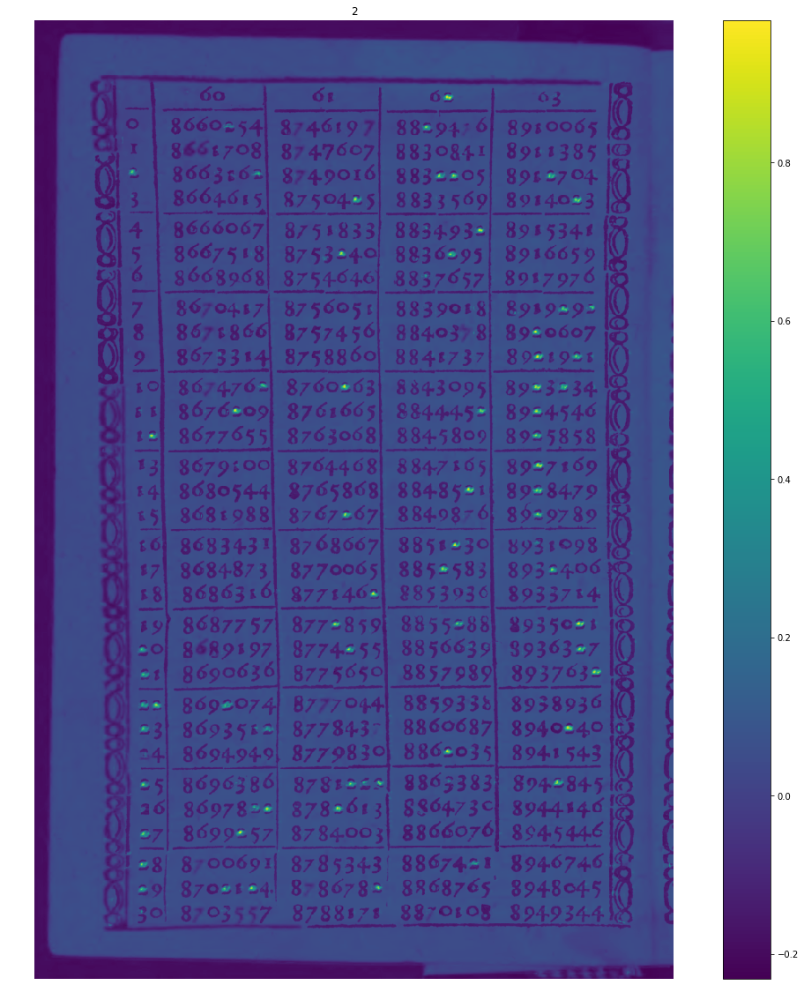

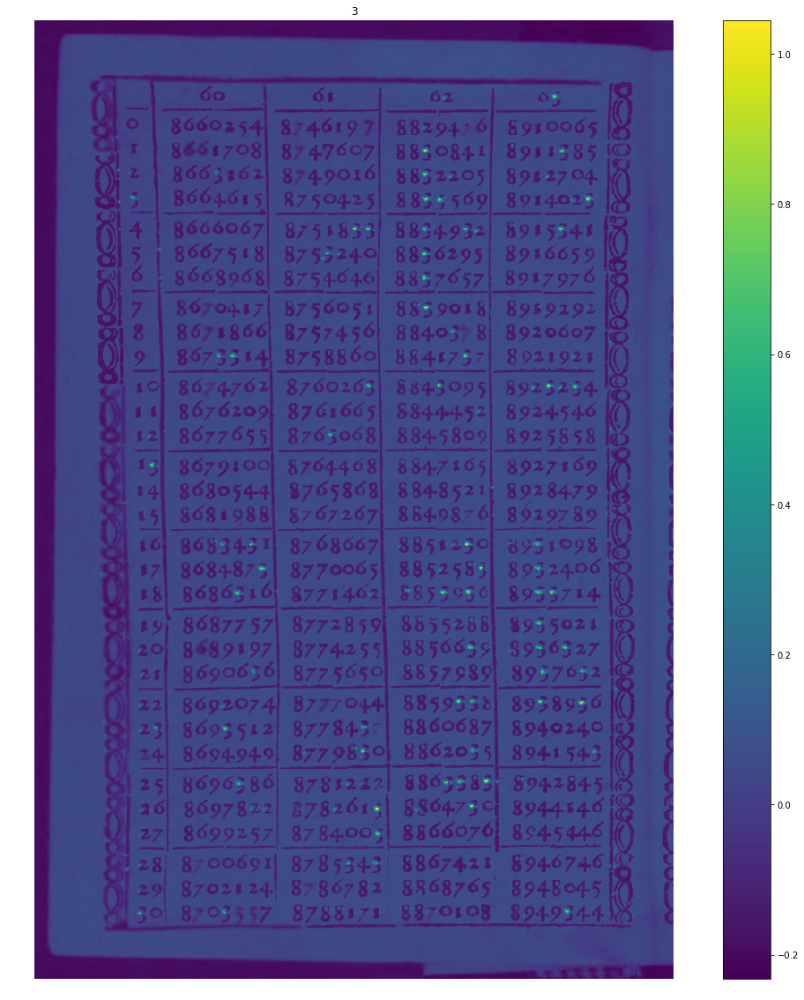

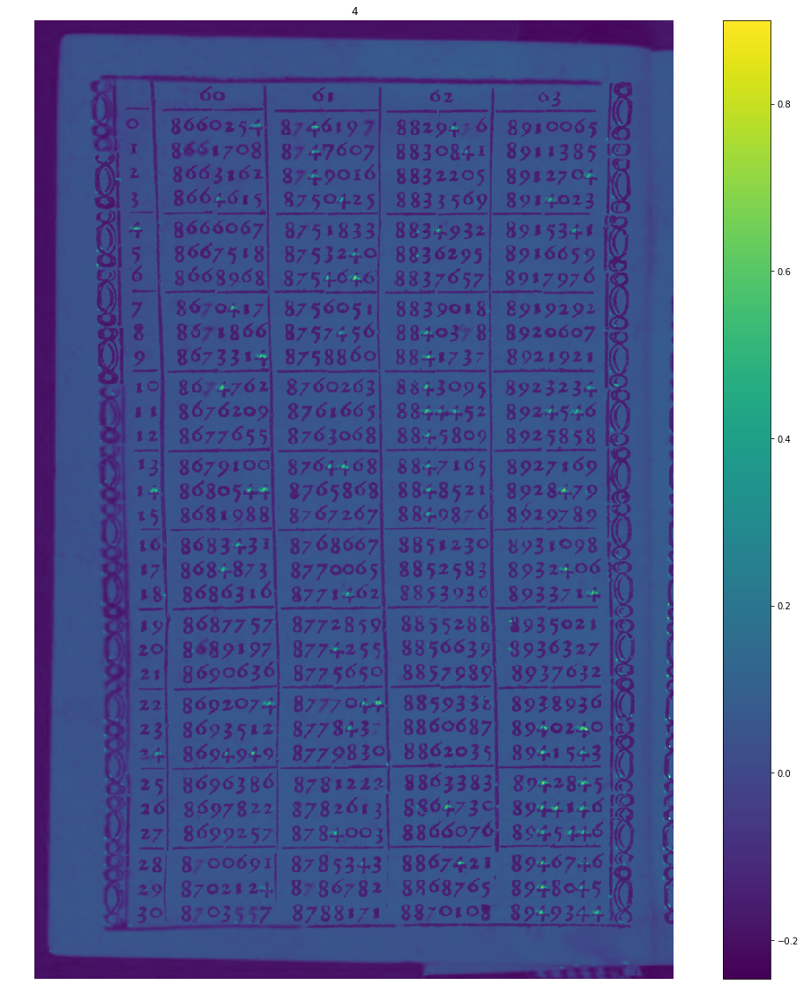

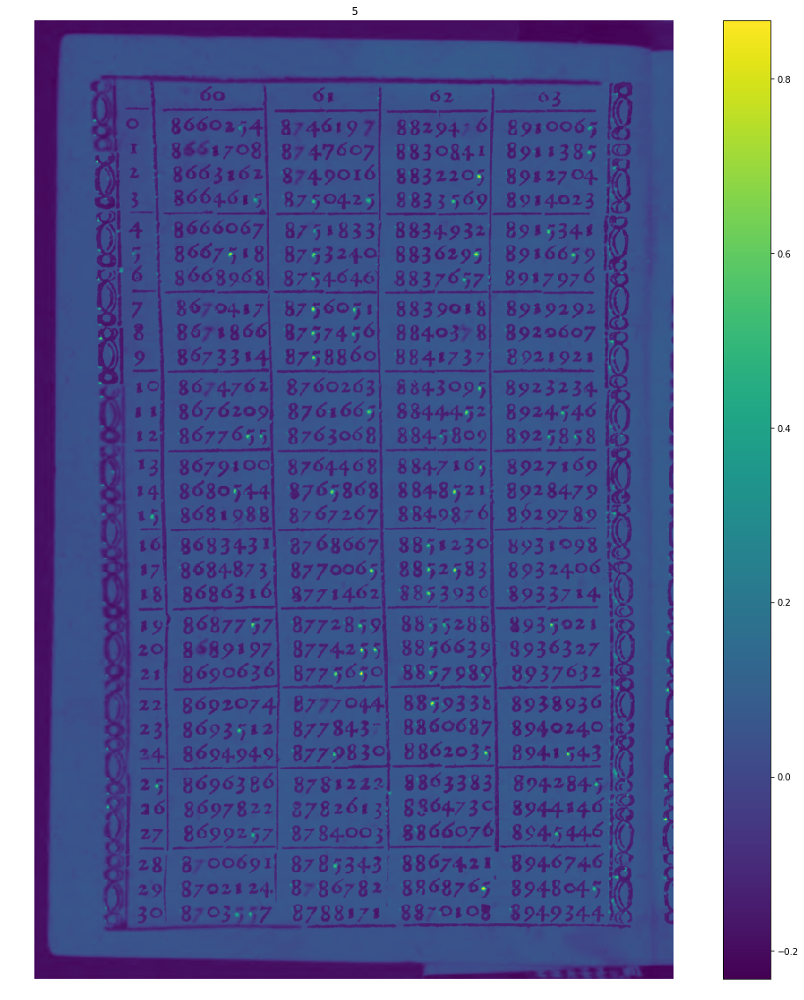

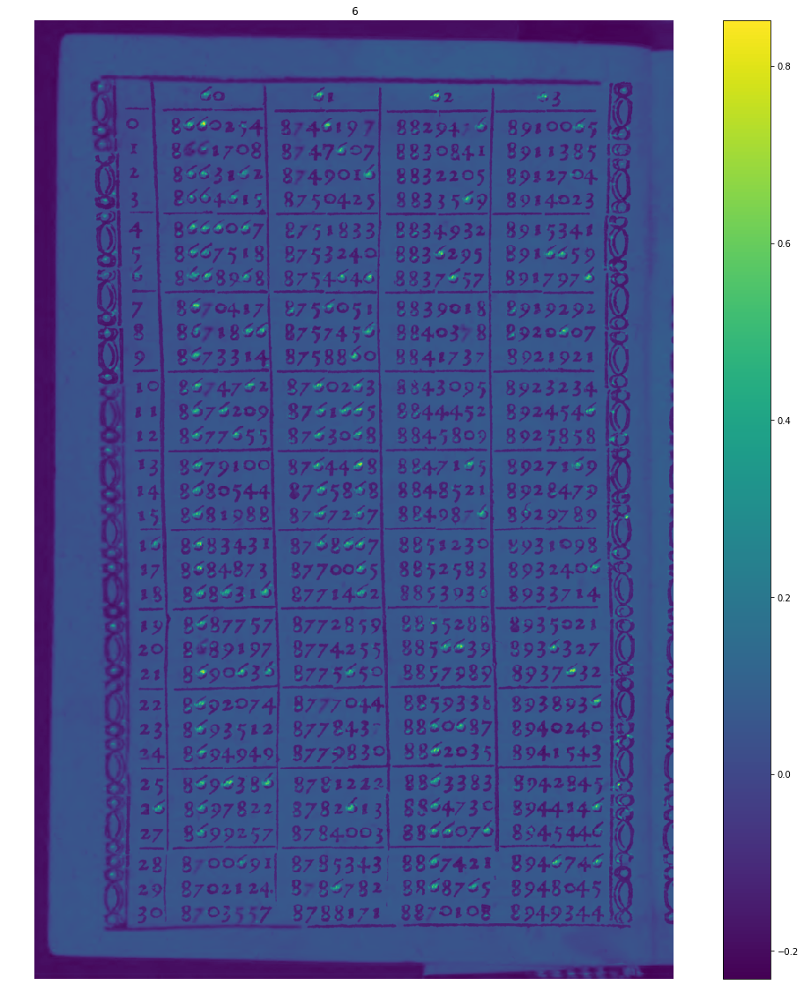

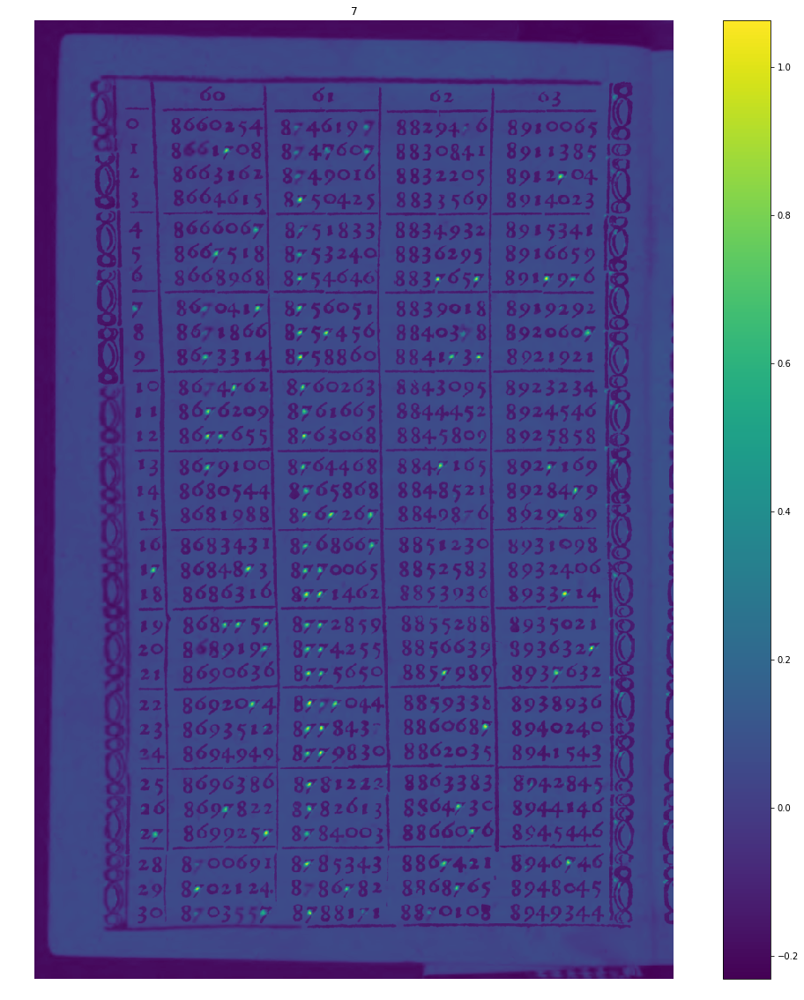

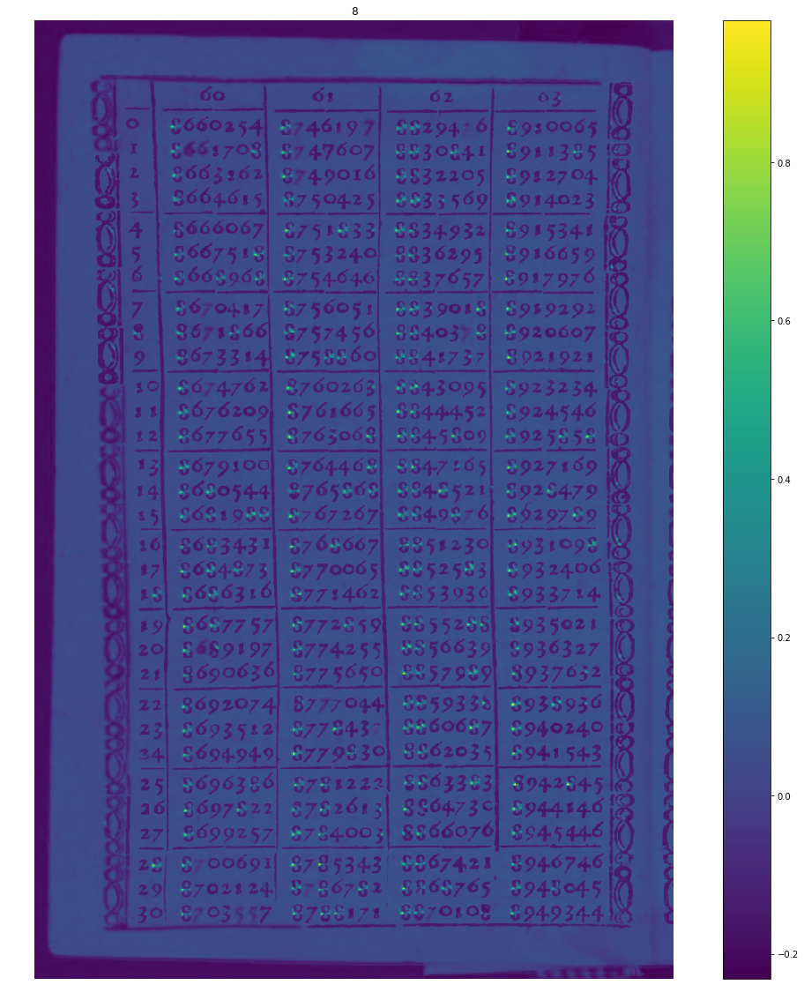

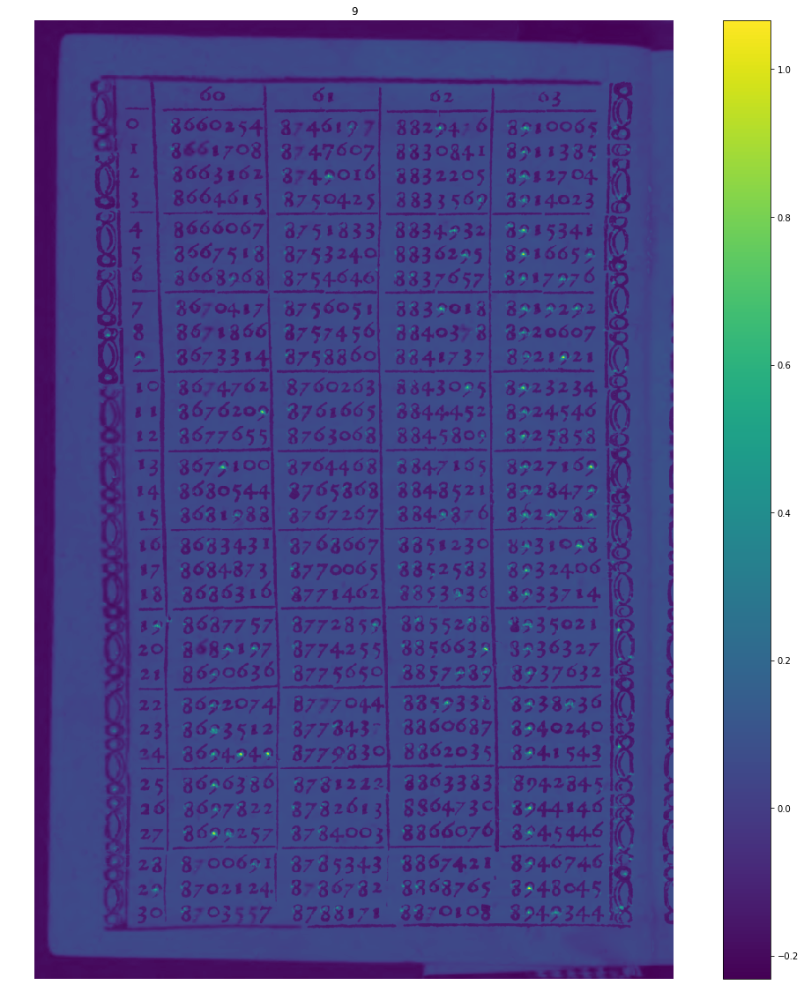

In [898]:
I = X_page.squeeze()
for i in range(10):
    plt.figure(figsize=(20,20))
    O_ = O_page[0,i,:,:].detach().cpu().squeeze()
    
    plt.imshow(0.1*I/I.max() + O_/O_.max())
    plt.title(i)
    plt.axis('off')
    plt.colorbar()
    plt.show()

In [52]:

def visualize_prediction(output, patch, mask = None):
    I = patch.squeeze()    
    f,axs = plt.subplots(2,5, figsize=(12,6))

    min_max = [((output[0,i,:,:]/output[0,:,:,:].max()).min().detach().cpu().numpy(), (output[0,i,:,:]/output[0,:,:,:].max()).max().detach().cpu().numpy()) for i in range(10)]

    min_, max_ = 1.1*np.min(min_max), 1.1*np.max(min_max)

    for i,ax in enumerate(axs.flatten()):

        O_ = output[0,i,:,:].detach().cpu().squeeze()/output[0,:,:,:].max()
        #print(O_.min(), O_.max())
        if mask is not None:
            P = 0.2*I/I.max() + 0.8*O_ +  0.1*(1-mask)
        else:
            P = 0.2*I/I.max() + 0.8*O_ 

        
        h = ax.imshow(P.squeeze(), vmax = max_ , vmin= min_)
        ax.set_title(i,  fontsize=15, y=0.985)
        ax.axis('off')
        
        
    cax = f.add_axes([0.43,0.2,0.5,0.2])
    cax.axis('off')
    cb = f.colorbar(h,  ax = cax, fraction=0.03, pad=0.02, aspect=15)
    cb.ax.tick_params(labelsize=12)
    plt.suptitle('True: {}'.format(''.join([str(int(l.detach().cpu().numpy())) for l in labels])), fontsize=15)
    f.subplots_adjust(hspace=0.15, wspace=0.01)

    plt.show()
    

#visualize_prediction(O, patch)   


# Training on context + bounding box

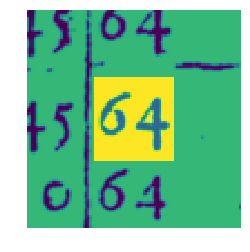

In [98]:
plt.imshow(patch.squeeze() + mask.squeeze())
plt.axis('off')
plt.show()

In [17]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [77]:
model  = CanvasModelBig()
modeldir = '/home/oeberle/explainable_embeds/experiments/06052019_mnist_canvas/historic_tuned_canvasmodel_patches_pad_30_not_masked.pt'
model.load_state_dict(torch.load(modeldir))
model.cuda()

CanvasModelBig(
  (encoder): Sequential(
    (0): Conv2d(1, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (1): ReLU(inplace)
    (2): Conv2d(64, 128, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (3): ReLU(inplace)
    (4): Conv2d(128, 256, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (5): ReLU(inplace)
    (6): Conv2d(256, 512, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), bias=False)
    (7): ReLU(inplace)
    (8): Conv2d(512, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (9): ReLU(inplace)
    (10): Conv2d(512, 10, kernel_size=(1, 1), stride=(1, 1), bias=False)
  )
)

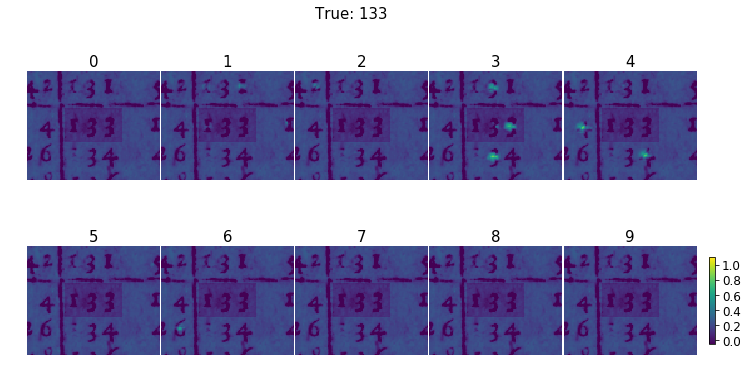

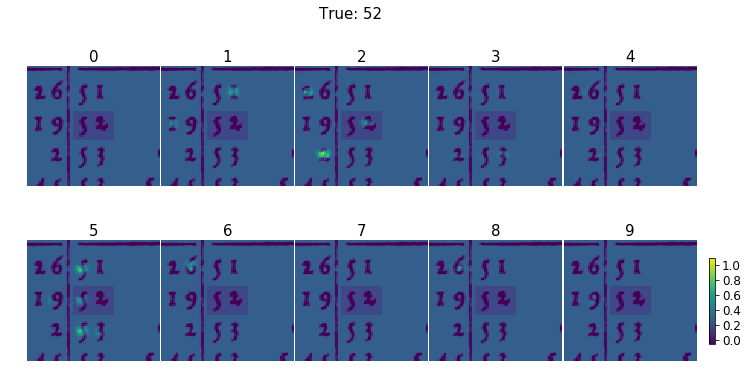

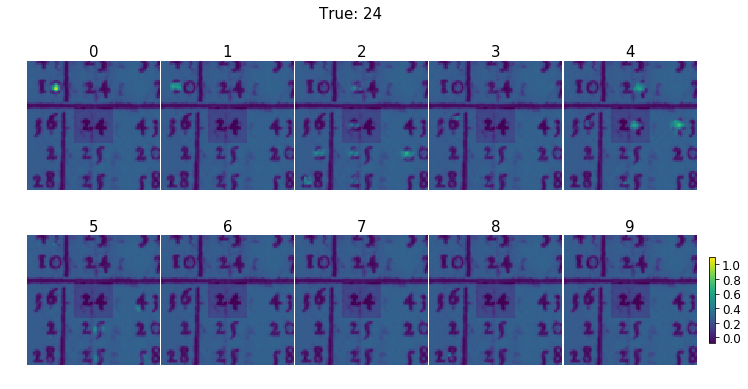

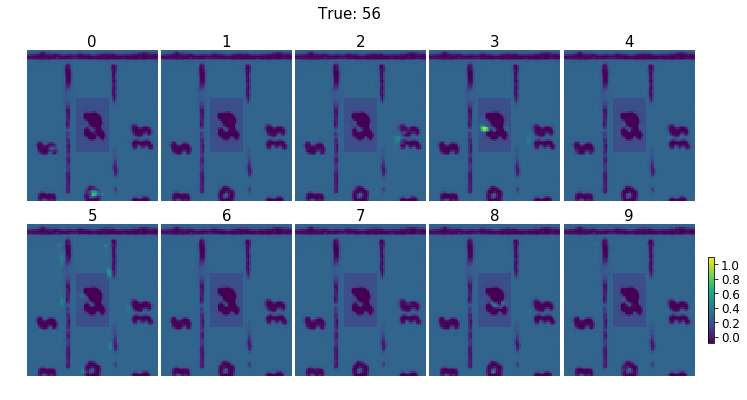

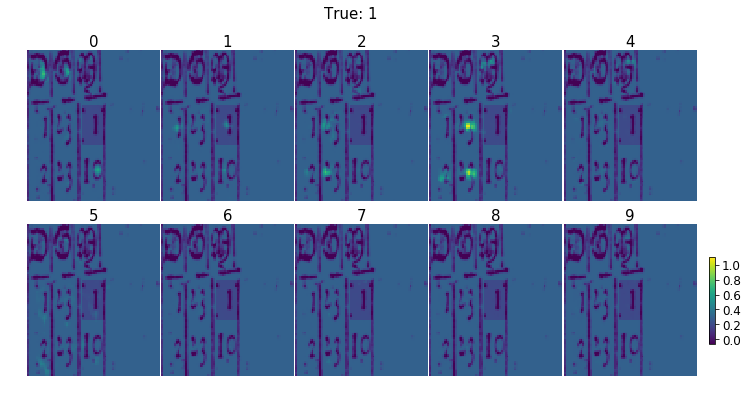

In [90]:
k = 0
with torch.no_grad():
    phase = 'test'
    for images, region, bboxes, labels in dataloaders[phase]:

        Y, patch, mask = get_historic_map(images[0,:,:,:],labels, bboxes , patch=False, extract_patch=True, pad=30)# for i in range(images.shape[0])]
        patch = patch.unsqueeze(0)

        X_ = patch - torch.mean(patch, dim=(2,3))
        X_page = images - torch.mean(images, dim=(2,3))

        inputs = X_.to(device)
        y_map = Y.to(device)

        O = model(X_.cuda())
 #       O_page = model(X_page.cuda())

        visualize_prediction(O, patch, mask)   
  #      visualize_prediction(O_page, X_page)   

        k+=1
    
        if k == 5:
            break